# Image segmentation with U-Net

This is a demostration of image segmentation performed on the Pascal VOC dataset by using U-Net. This notebook does not aim to solve the problem, but rather an implementation towards it.


In [1]:
# Ensure the corrent versions are used
!pip install torch==1.6.0
!pip install torchvision==0.7.0

In [2]:
# import all used packages
import numpy as np
import torch
import torch.nn as nn
import torch.nn.functional as F
import torchvision
import torchvision.transforms as T
from torchvision.datasets import VOCSegmentation
from torch.utils.data import DataLoader, Subset
import torch.optim as optim
from tqdm import tqdm

from PIL import Image
import matplotlib.pyplot as plt

In [3]:
device = 'cuda' if torch.cuda.is_available() else 'cpu'

In [4]:
!mkdir saved_models
!mkdir results

## U-Net

The implementation of the U-Net based on https://arxiv.org/pdf/1505.04597.pdf.

A few notes:
- Batch normalization is used (which was published right before the U-Net paper)
- In upsampling, the nearest neighbour is used instead of bilinear interpolation, because we want to have sharp edges around the segmenations
- Kernel size, padding are stride are defined the U-Net paper, but they are still used as arguments instead of hard-coded to make the implementation clearer.
- ConvNets in PyTorch do not have the padding options `same` and `valid` as in TensorFlow, when `padding=1` is set, the image is automatically retained the same size. Hence cropping the earlier conv results is not necessary.
- Batch size is set to `32` rather than `1` as in the paper.

In [5]:
class UNet(nn.Module):
    def conv_module(self, in_channels, out_channels):
        """
        Constructs a torch module Sequential
        :param in_channel: The number of input channels into the conv layers
        :param out_channel: The number of middle and out channels of the conv layers
        """
        return nn.Sequential(
            nn.Conv2d(in_channels=in_channels, out_channels=out_channels, kernel_size=self.K, padding=self.P),
            nn.BatchNorm2d(out_channels),
            nn.ReLU(),
            nn.Conv2d(in_channels=out_channels, out_channels=out_channels, kernel_size=self.K, padding=self.P),
            nn.BatchNorm2d(out_channels),
            nn.ReLU(),
        )

    def upsample_module(self, in_channels):        
        return nn.Sequential(
            # nn.UpsamplingBilinear2d(scale_factor=self.S), #Nearest2D is used to get sharp edges around segmenations
            nn.ConvTranspose2d(in_channels=in_channels, 
                               out_channels=in_channels // 2,
                               kernel_size=2,
                               stride=2)
        )

    def __init__(self, in_channel=3, out_channels=3, kernel_size=3, striding=2, padding=1):
        """
        Initiate Unet
        :param in_channel: The number of input channels, default 3 for RGB images
        :param out_channel: The number of out channels, default 3 for RGB images
        :param kernel_size: The kernal size of the convolution, default 3x3
        :param striding: The striding length, default 1
        :param padding: The padding of convolution, default 1
        """
        super(UNet, self).__init__()

        # Assign and abbreviate the variables as CV conventions
        self.C = in_channel
        self.K = kernel_size
        self.S = striding
        self.P = padding

        # Convolution components in the U-Net
        self.conv1 = self.conv_module(in_channel, 64)
        self.conv2 = self.conv_module(64, 128)
        self.conv3 = self.conv_module(128, 256)
        self.conv4 = self.conv_module(256, 512)
        self.conv5 = self.conv_module(512, 1024)
        self.conv6 = self.conv_module(1024, 512)
        self.conv7 = self.conv_module(512, 256)
        self.conv8 = self.conv_module(256, 128)
        self.conv9 = self.conv_module(128, 64)

        # Upsampling modules
        self.upsample1 = self.upsample_module(1024)
        self.upsample2 = self.upsample_module(512)
        self.upsample3 = self.upsample_module(256)
        self.upsample4 = self.upsample_module(128)
        
        # Other modules
        self.maxpool2D = nn.MaxPool2d(kernel_size=2, stride=self.S, padding=0)
        self.conv1x1 = nn.Conv2d(in_channels=64,
                                 out_channels=out_channels,
                                 kernel_size=1,
                                 padding=0)

    def forward(self, input):
        # Encoder - downsampling
        conv1_out = self.conv1(input)
        conv2_out = self.conv2(self.maxpool2D(conv1_out))
        conv3_out = self.conv3(self.maxpool2D(conv2_out))
        conv4_out = self.conv4(self.maxpool2D(conv3_out))

        # Middle layer
        # using the same object to optimize memory usage
        next = self.conv5(self.maxpool2D(conv4_out))

        # Decoder - upsampling
        next = self.upsample1(next)
        next = torch.cat([conv4_out, next], dim=1)
        next = self.conv6(next)

        next = self.upsample2(next)
        next = torch.cat([conv3_out, next], dim=1)
        next = self.conv7(next)

        next = self.upsample3(next)
        next = torch.cat([conv2_out, next], dim=1)
        next = self.conv8(next)

        next = self.upsample4(next)
        next = torch.cat([conv1_out, next], dim=1)
        next = self.conv9(next)

        out = self.conv1x1(next)
        return out

## Training settings


In [9]:
# Training settings and parameters
seed = 42
lr = 1e-3
epochs = 200
batch_size = 4

print_every_step = 1

save_output_every = 10
save_model_every = 20

image_resize = 128
train_dataset_size = 1000
test_dataset_size = 100

## Dataset

For this segmentation task, we use the VOC segmentation dataset from torchvision. The images are cropped at the center of the size of 256x256 to reduce computation. Because this is not aimed for hyperparameter tuning, the validation dataset is omitted. The model will be evaluated directly on the test dataset with the given hyperparameters.

In [10]:
def load_datasets():
    """
    Get datasets and data loaders from torchvision
    """
    transform = T.Compose([
        T.Resize((image_resize, image_resize)), # to make life easier
        T.ToTensor(),
    ])

    train_dataset = VOCSegmentation(
                        './data/VOCSegmentation',
                        image_set='train',
                        download=True,
                        transform=transform,
                        target_transform=transform
                        )    
    
    test_dataset = VOCSegmentation(
                        './data/VOCSegmentation',
                        image_set='val',
                        download=True,
                        transform=transform,
                        target_transform=transform
                        )
    
    train_dataset = Subset(train_dataset, np.arange(train_dataset_size))
    test_dataset = Subset(test_dataset, np.arange(test_dataset_size))

    train_loader = DataLoader(train_dataset,
                              batch_size=batch_size,
                              shuffle=True,
                             )

    test_loader = DataLoader(test_dataset,
                             batch_size=batch_size,
                             shuffle=False,
                            )

    return train_loader, test_loader

train_loader, test_loader = load_datasets()
print('Data loaders ready')

Using downloaded and verified file: ./data/VOCSegmentation/VOCtrainval_11-May-2012.tar
Data loaders ready


## Training helper functions

In [11]:
def save_model(epoch, model):
    torch.save(model.state_dict(), f'./saved_models/model_{epoch}.pt')
    

In [12]:
def save_result(epoch, input, pred, target):
    """
    Visualize the input, prediction and target
    Data from from the first images in the batch
    """
    input, pred, target = input[0], pred[0].argmax(0), target[0]

    # Credit to Pytorch tutortial https://pytorch.org/hub/pytorch_vision_deeplabv3_resnet101/
    # create a color pallette, selecting a color for each class
    palette = torch.tensor([2 ** 25 - 1, 2 ** 15 - 1, 2 ** 21 - 1])
    colors = torch.as_tensor([i for i in range(21)])[:, None] * palette
    colors = (colors % 255).numpy().astype("uint8")

    # plot the semantic segmentation predictions of 21 classes in each color
    r1 = Image.fromarray((input*255).byte().cpu().transpose(0,2).transpose(0,1).numpy())
    r2 = Image.fromarray(pred.byte().cpu().numpy())
    r3 = Image.fromarray(target.byte().cpu().numpy())

    r2.putpalette(colors)
    r3.putpalette(colors)

    fig=plt.figure(figsize=(16,16))
    fig.add_subplot(1,3,1);plt.imshow(r1)
    fig.add_subplot(1,3,2);plt.imshow(r2)
    fig.add_subplot(1,3,3);plt.imshow(r3)

    plt.show()

In [13]:
def get_accuracy(input, target):
    """
    Get the pixel level accuracy as the target
    """
    correct = (input.argmax(dim=1) == target).sum().item()
    total = image_resize ** 2 * batch_size
    
    return correct / total

def preprocess_target(target):
    # convert target to index labels
    target = (target * 255).long() # convert [0., 1.] to [0, 255]
    target = target.squeeze(dim=1)
    
    # And to make life easier, we don't care about the white borders
    target[target == 255] = 0

    return target
    


In [14]:
def dice_loss(pred, target, smooth=1):
    pred = F.softmax(pred)

    intersection = (pred * target).sum(dim=1)
    unionset = pred.sum(dim=1) + target.sum(dim=1)
    loss = 2. * (intersection + smooth) / (unionset + smooth)
 
    return loss.sum() / target.shape[0]

## Training 

Cross entropy loss is used for training.
After every epoch, the first image in the batch is displayed,
with the order input-preditionc-label.

In [15]:
def get_weight():
    """
    Get the weights per class for the cross entropy loss
    """
    all_targets = []
    for _, target in train_loader.dataset:
        target *= 255
        target[target == 255] = 0 # remove boarders
        all_targets.append(target.numpy())
    # all_targets.append([target.numpy() * 255 for _, target in train_dataset])
    all_targets = np.array(all_targets)
    unique = np.unique(all_targets, return_counts = True)

    weights = unique[1].sum() / unique[1]
    return torch.tensor(weights).float().to(device)


In [16]:
model = UNet(out_channels=21).to(device)

In [17]:
optimizer = optim.Adam(model.parameters(), lr=lr)
CE_weight = get_weight()
criterion = nn.CrossEntropyLoss(CE_weight)

------------------------------ Epoch 1 ------------------------------
Loss: 3.061   Accuracy: 0.086


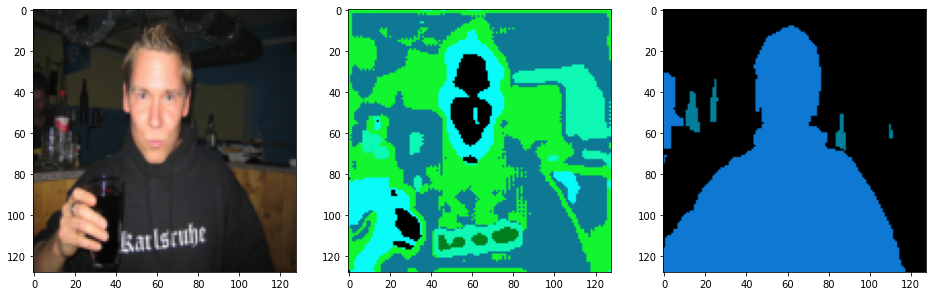

------------------------------ Epoch 2 ------------------------------
Loss: 3.010   Accuracy: 0.157


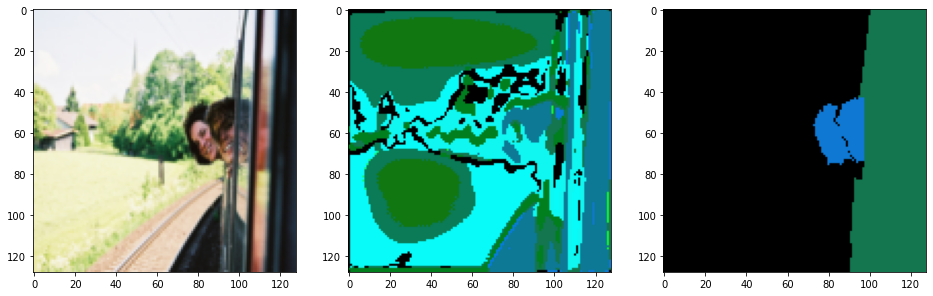

------------------------------ Epoch 3 ------------------------------
Loss: 2.976   Accuracy: 0.176


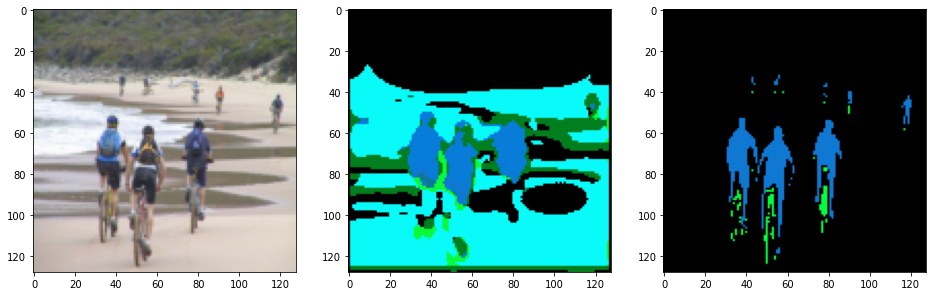

------------------------------ Epoch 4 ------------------------------
Loss: 2.955   Accuracy: 0.216


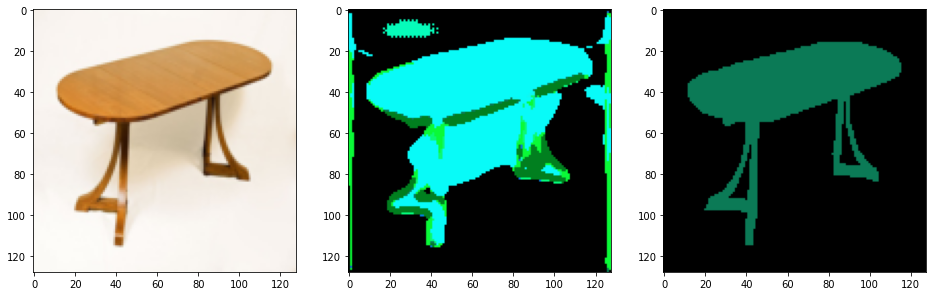

------------------------------ Epoch 5 ------------------------------
Loss: 2.908   Accuracy: 0.212


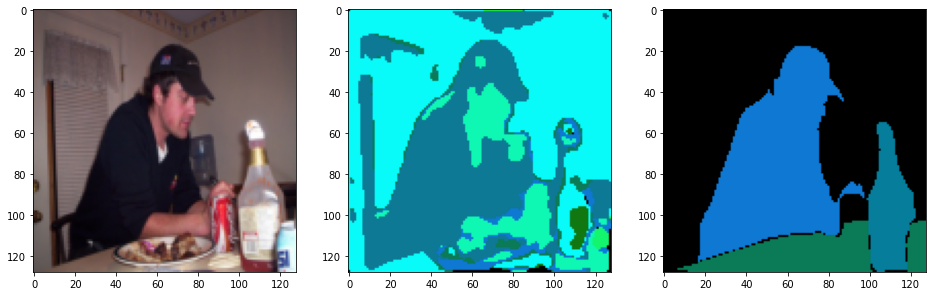

------------------------------ Epoch 6 ------------------------------
Loss: 2.877   Accuracy: 0.215


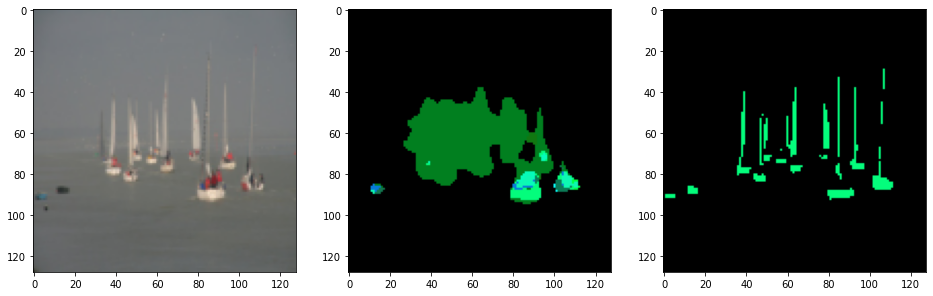

------------------------------ Epoch 7 ------------------------------
Loss: 2.859   Accuracy: 0.254


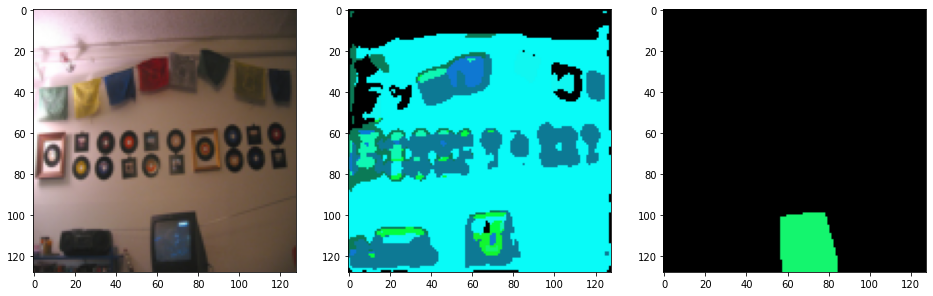

------------------------------ Epoch 8 ------------------------------
Loss: 2.820   Accuracy: 0.258


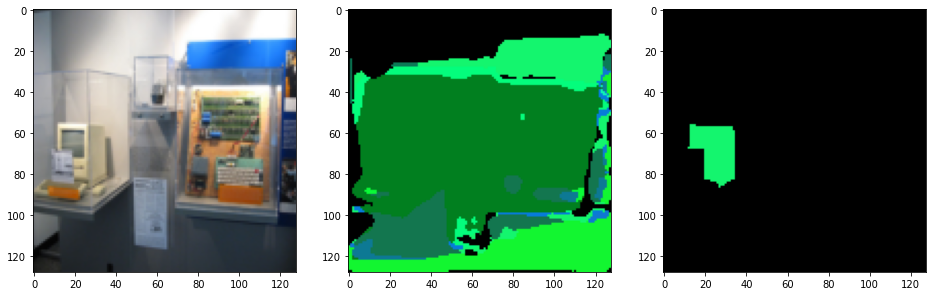

------------------------------ Epoch 9 ------------------------------
Loss: 2.809   Accuracy: 0.230


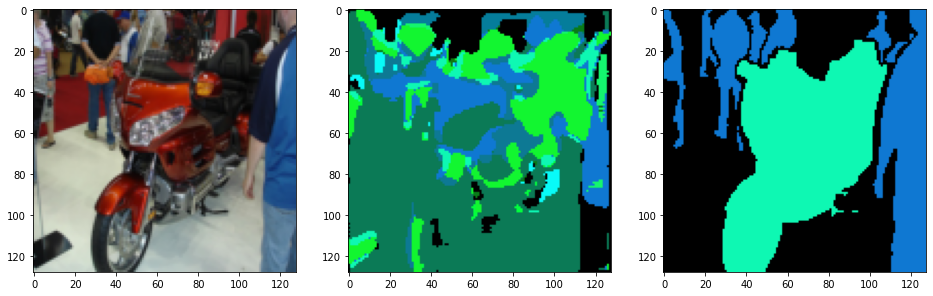

------------------------------ Epoch 10 ------------------------------
Loss: 2.803   Accuracy: 0.245


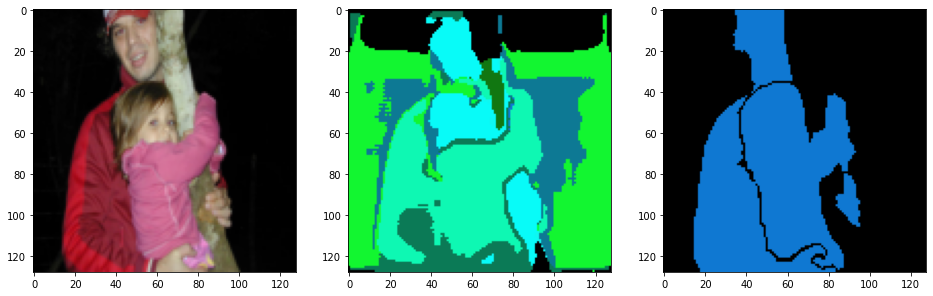

------------------------------ Epoch 11 ------------------------------
Loss: 2.787   Accuracy: 0.232


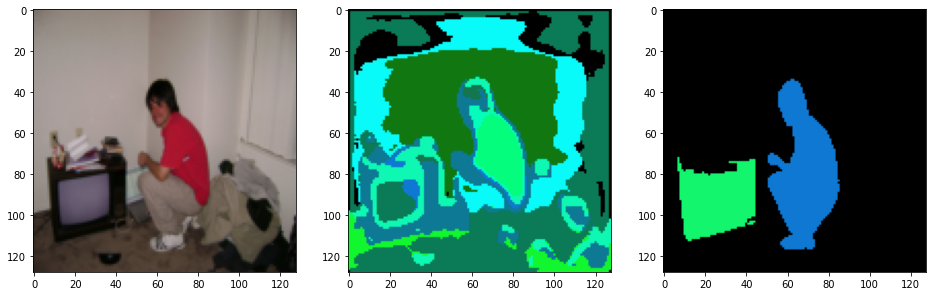

------------------------------ Epoch 12 ------------------------------
Loss: 2.769   Accuracy: 0.213


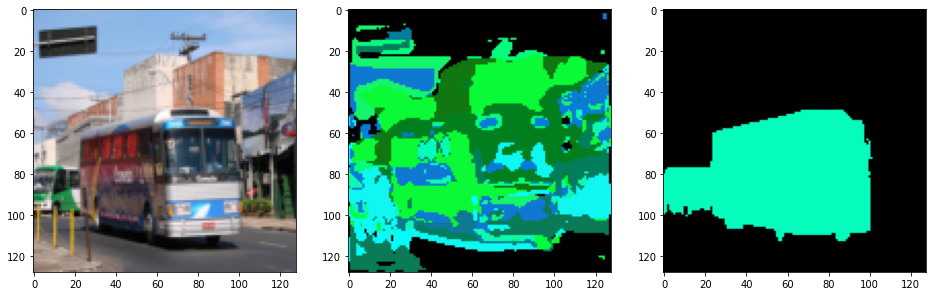

------------------------------ Epoch 13 ------------------------------
Loss: 2.739   Accuracy: 0.238


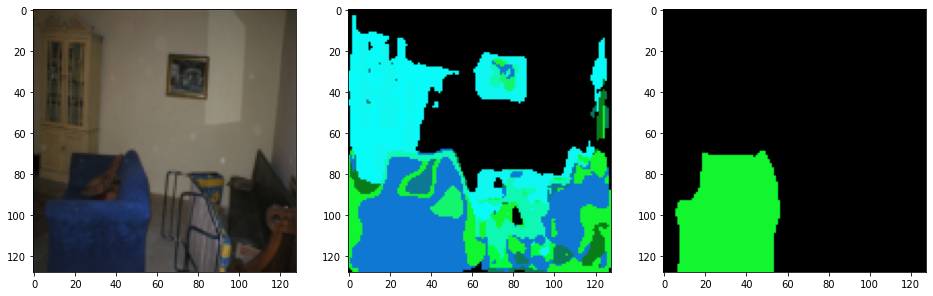

------------------------------ Epoch 14 ------------------------------
Loss: 2.713   Accuracy: 0.249


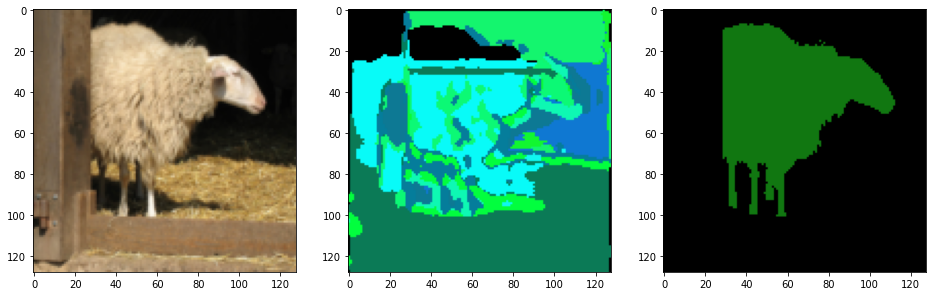

------------------------------ Epoch 15 ------------------------------
Loss: 2.709   Accuracy: 0.252


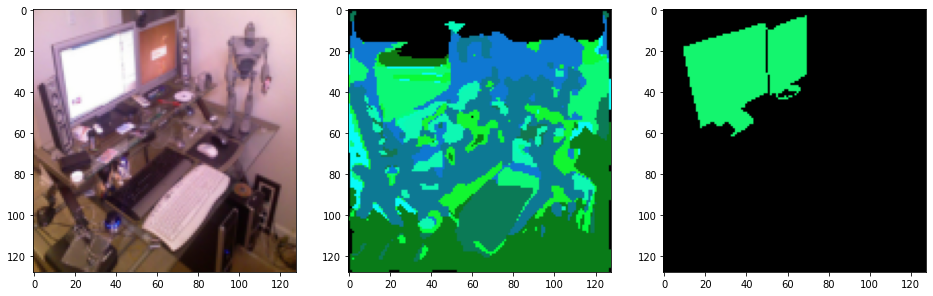

------------------------------ Epoch 16 ------------------------------
Loss: 2.702   Accuracy: 0.265


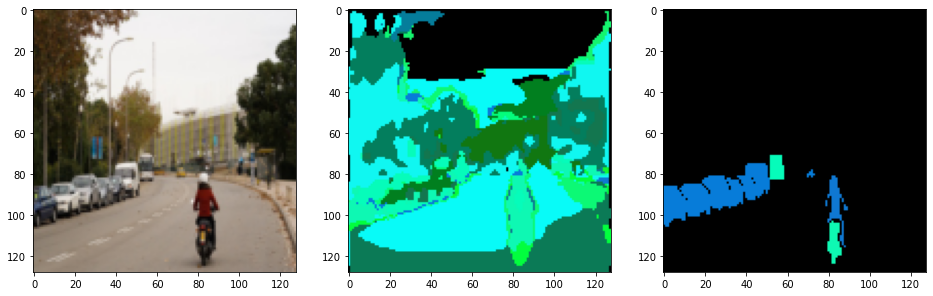

------------------------------ Epoch 17 ------------------------------
Loss: 2.691   Accuracy: 0.251


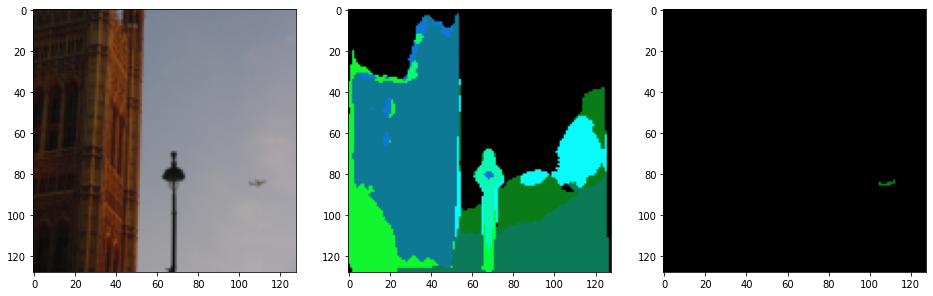

------------------------------ Epoch 18 ------------------------------
Loss: 2.683   Accuracy: 0.256


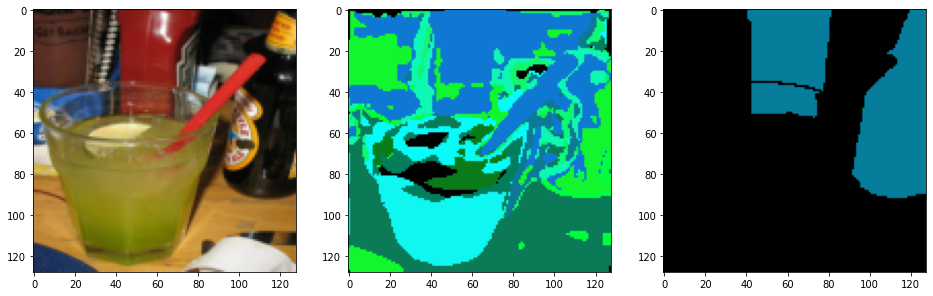

------------------------------ Epoch 19 ------------------------------
Loss: 2.684   Accuracy: 0.243


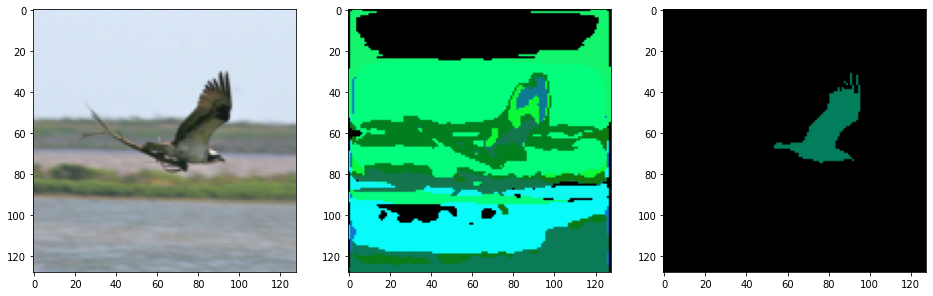

------------------------------ Epoch 20 ------------------------------
Loss: 2.668   Accuracy: 0.252


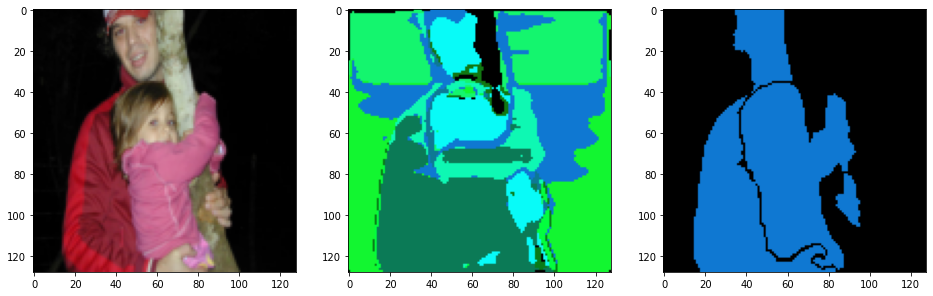

------------------------------ Epoch 21 ------------------------------
Loss: 2.656   Accuracy: 0.233


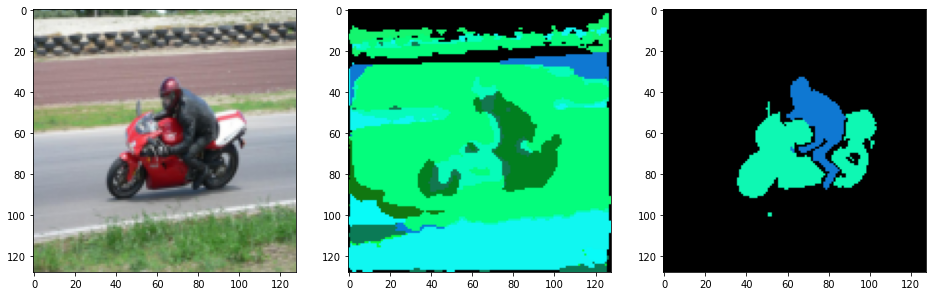

------------------------------ Epoch 22 ------------------------------
Loss: 2.629   Accuracy: 0.249


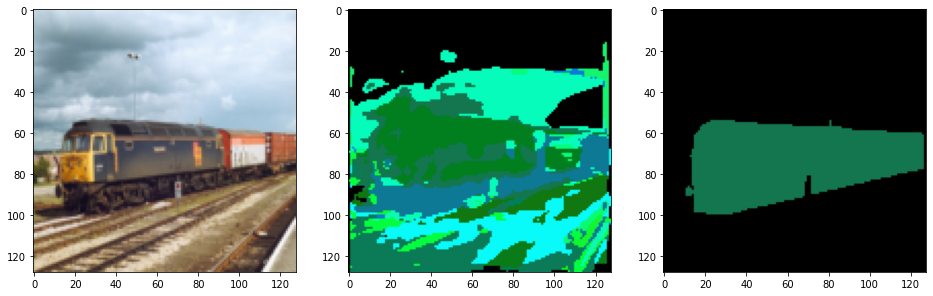

------------------------------ Epoch 23 ------------------------------
Loss: 2.647   Accuracy: 0.258


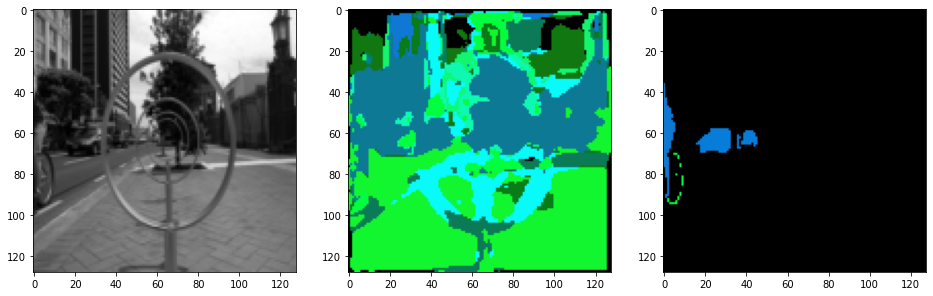

------------------------------ Epoch 24 ------------------------------
Loss: 2.619   Accuracy: 0.269


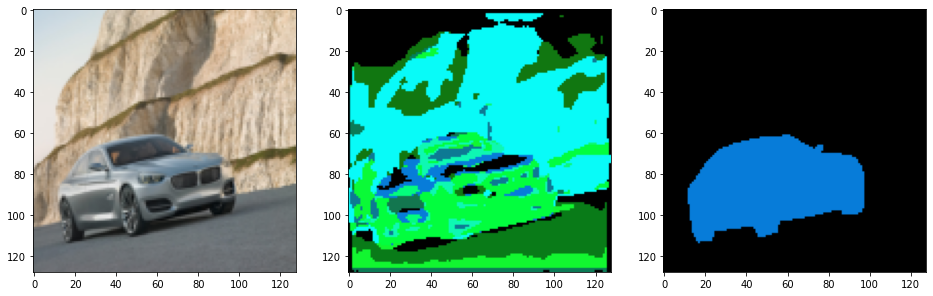

------------------------------ Epoch 25 ------------------------------
Loss: 2.629   Accuracy: 0.267


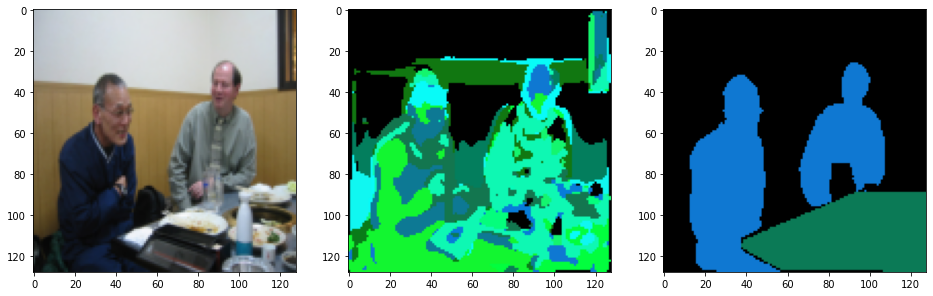

------------------------------ Epoch 26 ------------------------------
Loss: 2.581   Accuracy: 0.268


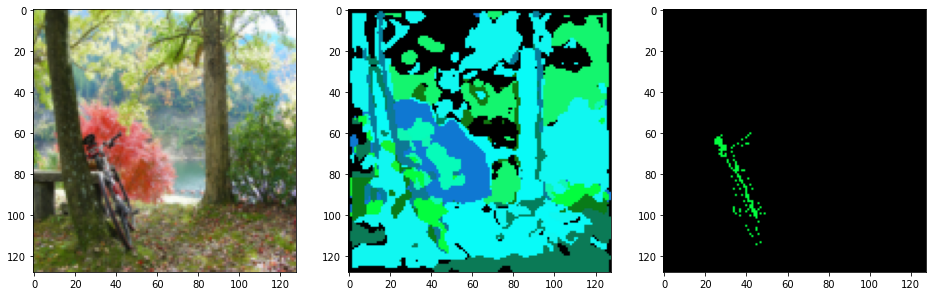

------------------------------ Epoch 27 ------------------------------
Loss: 2.597   Accuracy: 0.274


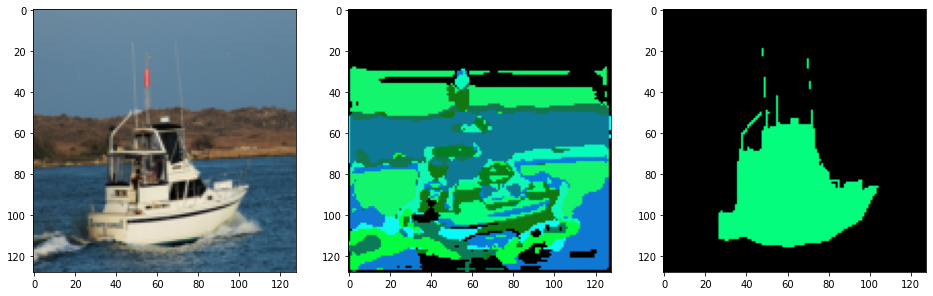

------------------------------ Epoch 28 ------------------------------
Loss: 2.566   Accuracy: 0.267


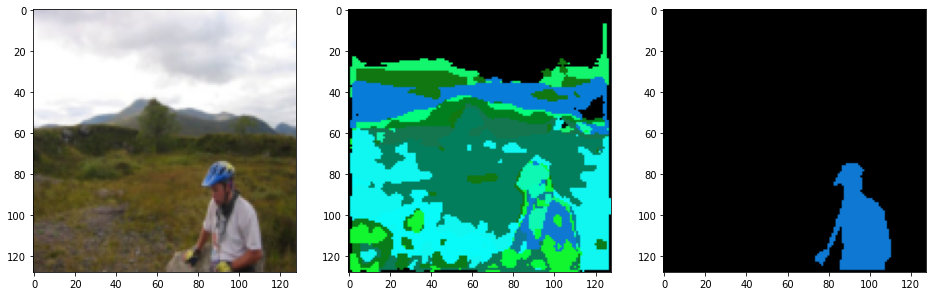

------------------------------ Epoch 29 ------------------------------
Loss: 2.574   Accuracy: 0.278


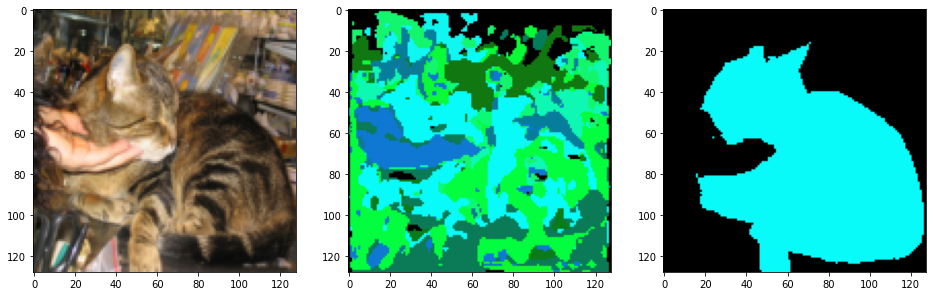

------------------------------ Epoch 30 ------------------------------
Loss: 2.551   Accuracy: 0.268


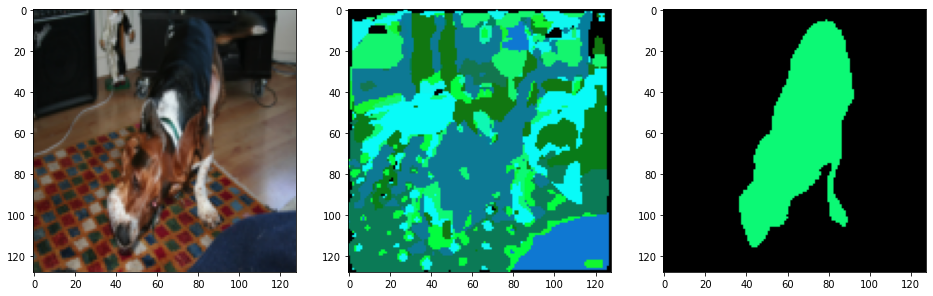

------------------------------ Epoch 31 ------------------------------
Loss: 2.544   Accuracy: 0.274


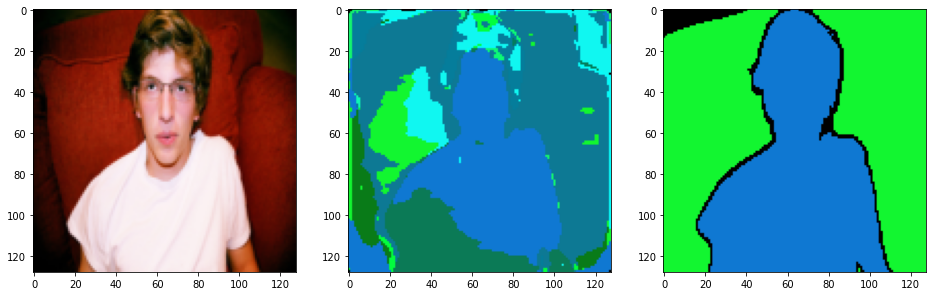

------------------------------ Epoch 32 ------------------------------
Loss: 2.536   Accuracy: 0.290


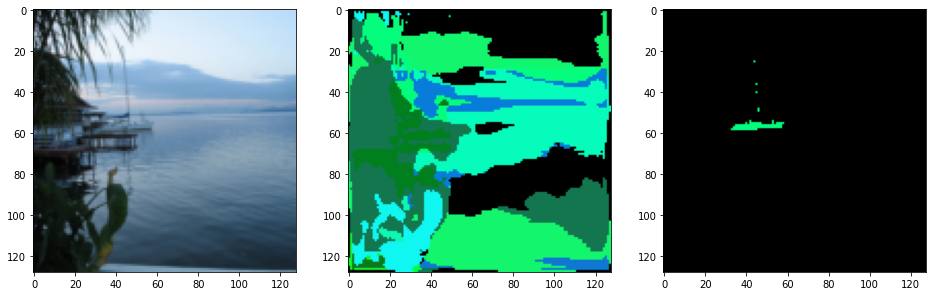

------------------------------ Epoch 33 ------------------------------
Loss: 2.493   Accuracy: 0.268


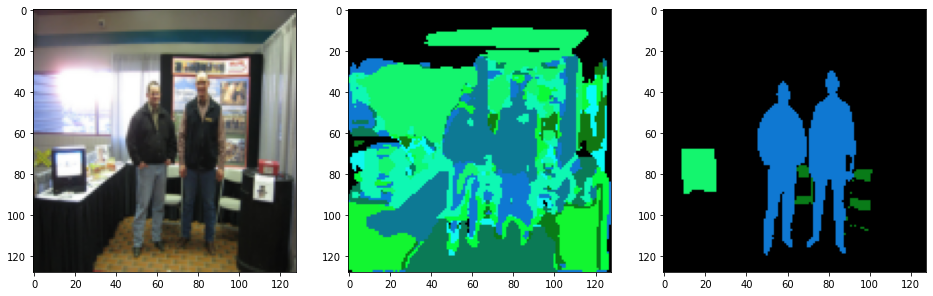

------------------------------ Epoch 34 ------------------------------
Loss: 2.515   Accuracy: 0.298


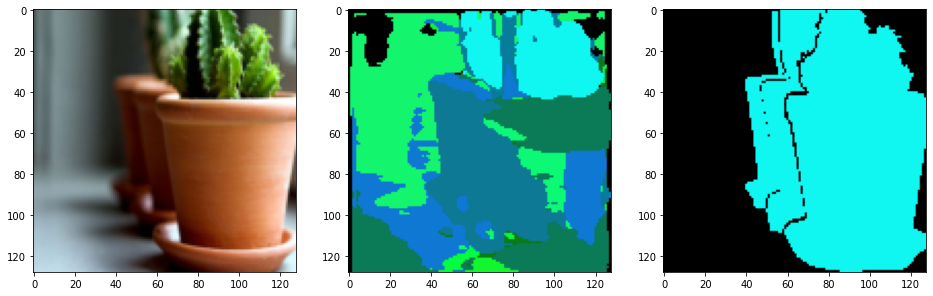

------------------------------ Epoch 35 ------------------------------
Loss: 2.512   Accuracy: 0.272


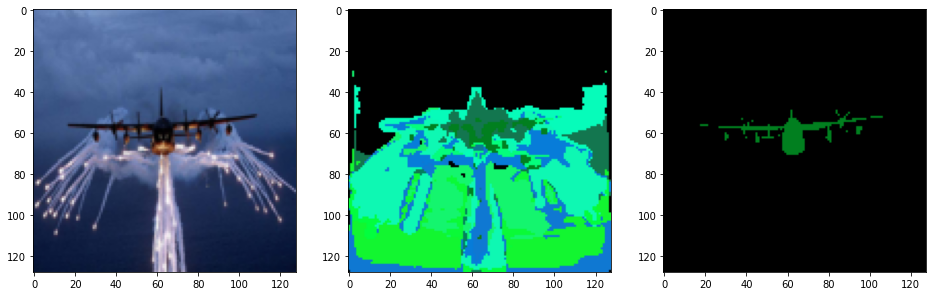

------------------------------ Epoch 36 ------------------------------
Loss: 2.516   Accuracy: 0.294


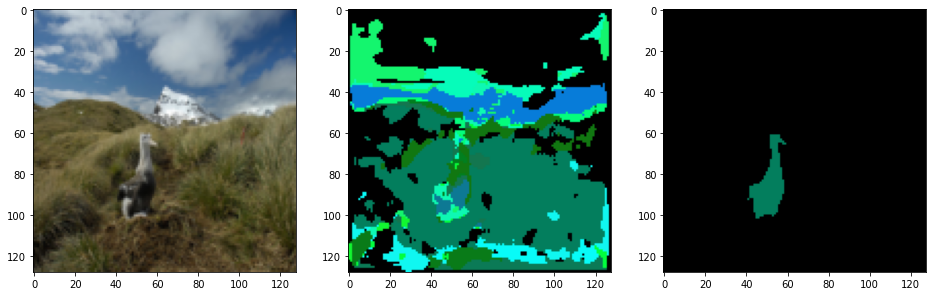

------------------------------ Epoch 37 ------------------------------
Loss: 2.475   Accuracy: 0.282


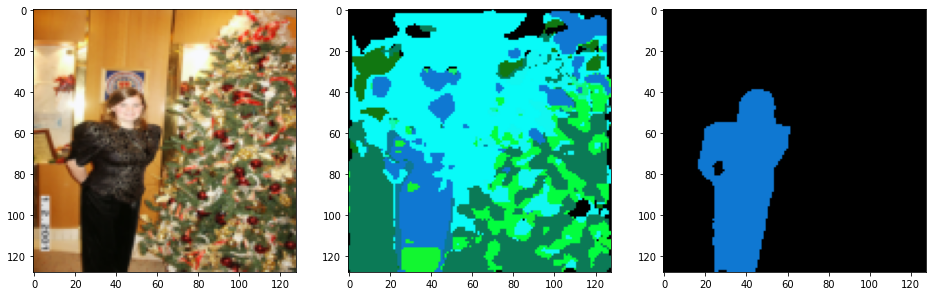

------------------------------ Epoch 38 ------------------------------
Loss: 2.483   Accuracy: 0.281


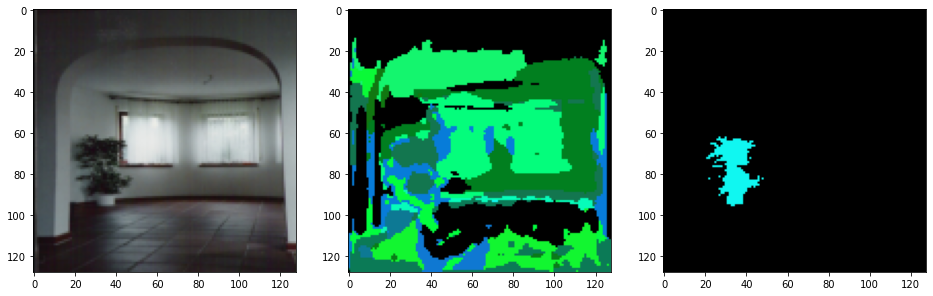

------------------------------ Epoch 39 ------------------------------
Loss: 2.479   Accuracy: 0.290


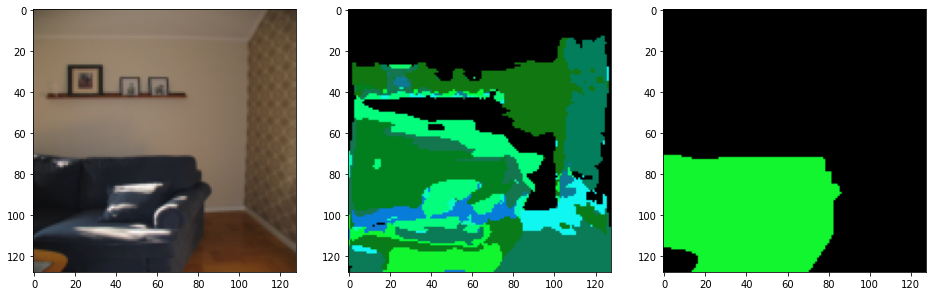

------------------------------ Epoch 40 ------------------------------
Loss: 2.443   Accuracy: 0.286


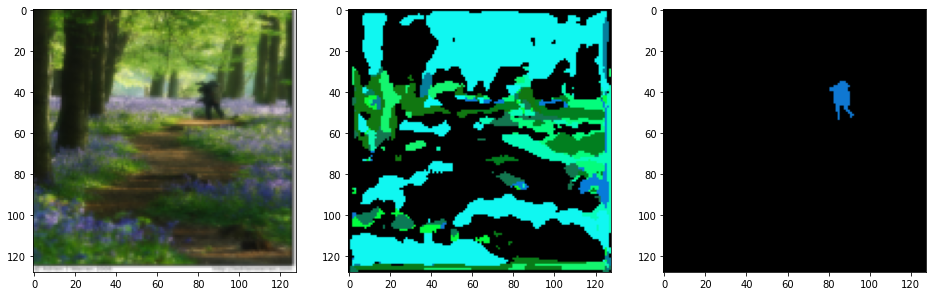

------------------------------ Epoch 41 ------------------------------
Loss: 2.439   Accuracy: 0.289


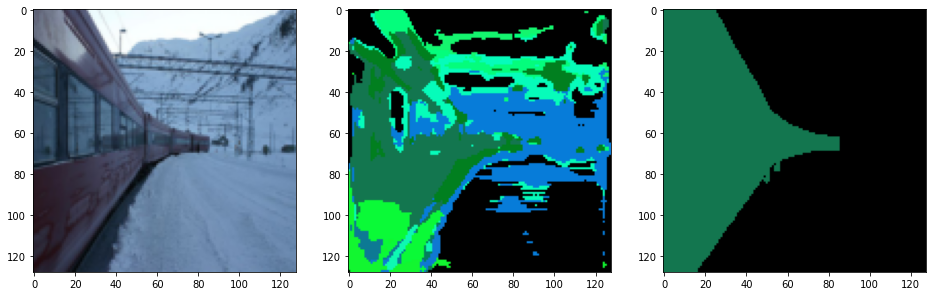

------------------------------ Epoch 42 ------------------------------
Loss: 2.445   Accuracy: 0.294


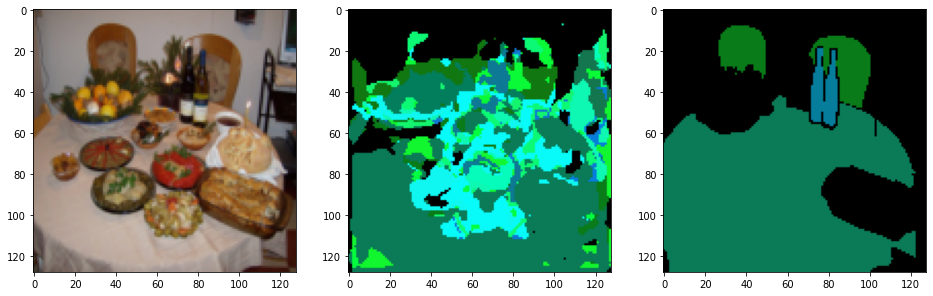

------------------------------ Epoch 43 ------------------------------
Loss: 2.429   Accuracy: 0.299


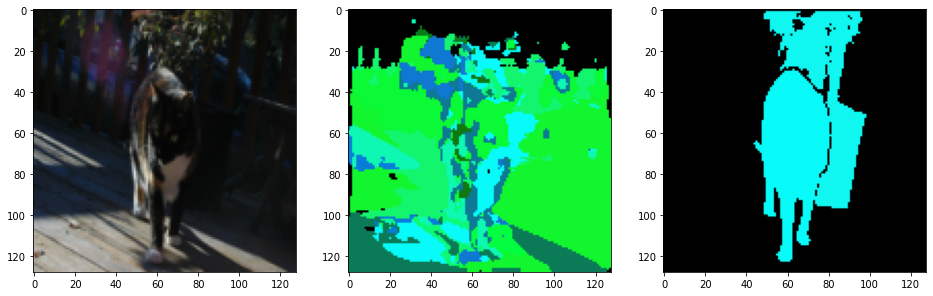

------------------------------ Epoch 44 ------------------------------
Loss: 2.393   Accuracy: 0.291


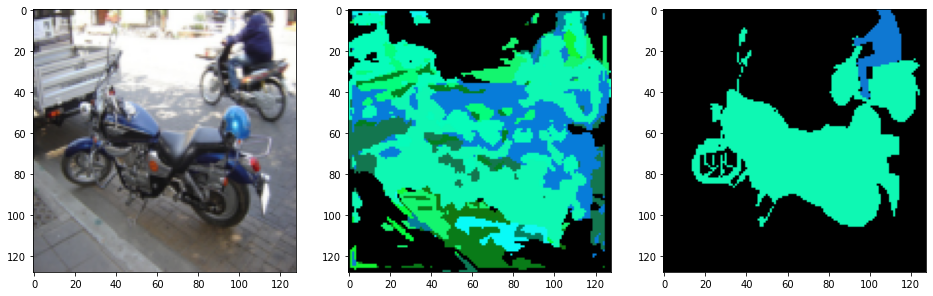

------------------------------ Epoch 45 ------------------------------
Loss: 2.392   Accuracy: 0.303


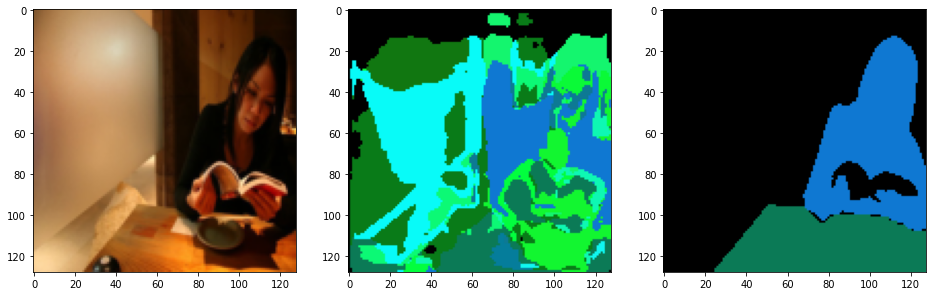

------------------------------ Epoch 46 ------------------------------
Loss: 2.382   Accuracy: 0.286


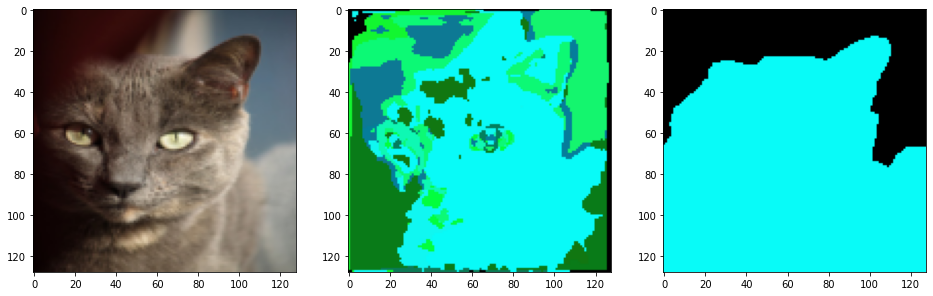

------------------------------ Epoch 47 ------------------------------
Loss: 2.332   Accuracy: 0.297


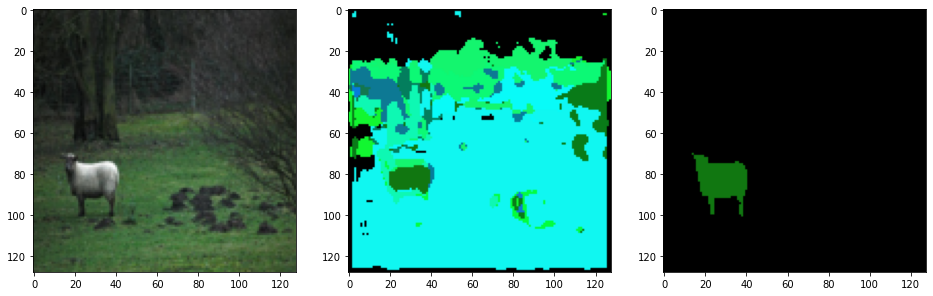

------------------------------ Epoch 48 ------------------------------
Loss: 2.371   Accuracy: 0.284


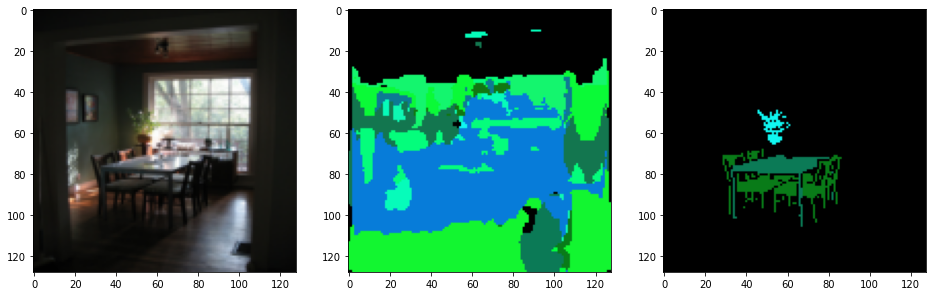

------------------------------ Epoch 49 ------------------------------
Loss: 2.339   Accuracy: 0.285


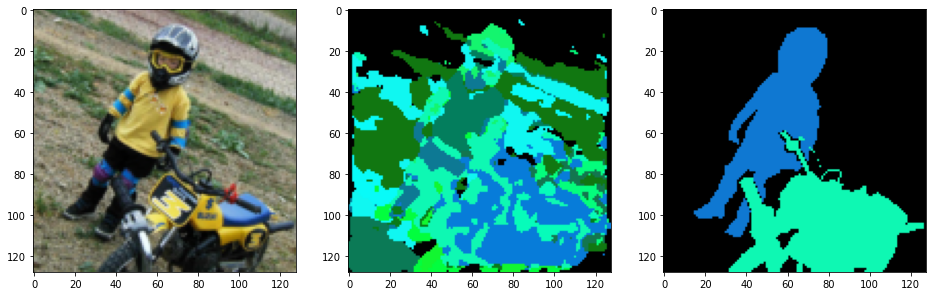

------------------------------ Epoch 50 ------------------------------
Loss: 2.304   Accuracy: 0.288


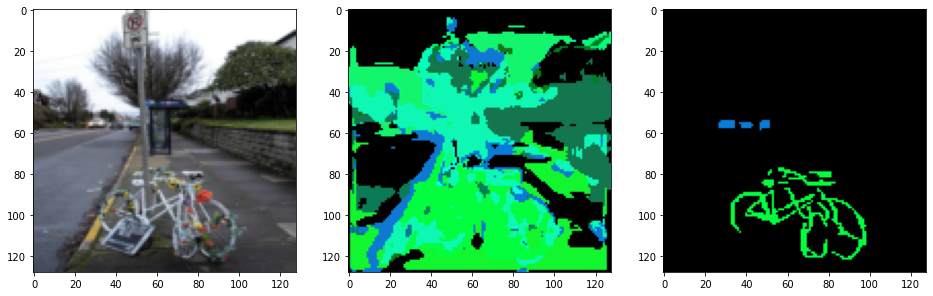

------------------------------ Epoch 51 ------------------------------
Loss: 2.363   Accuracy: 0.289


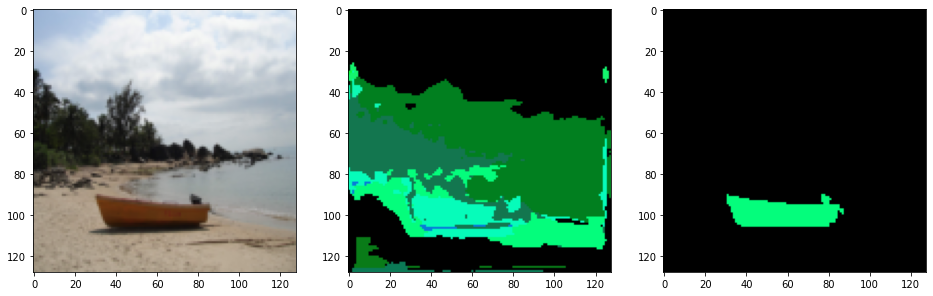

------------------------------ Epoch 52 ------------------------------
Loss: 2.328   Accuracy: 0.279


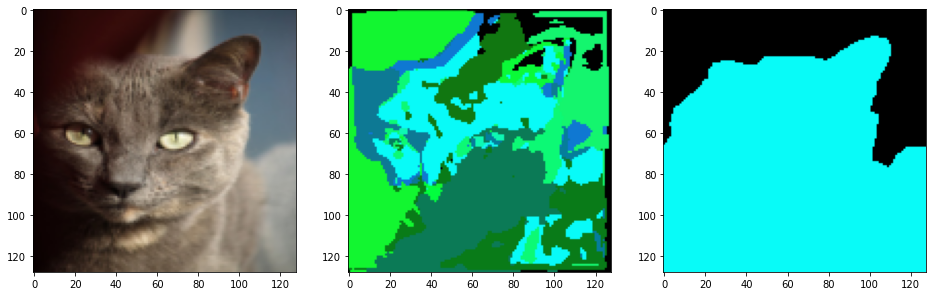

------------------------------ Epoch 53 ------------------------------
Loss: 2.296   Accuracy: 0.293


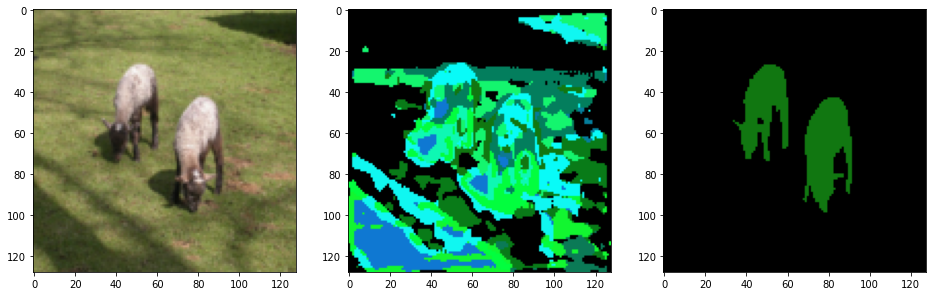

------------------------------ Epoch 54 ------------------------------
Loss: 2.283   Accuracy: 0.285


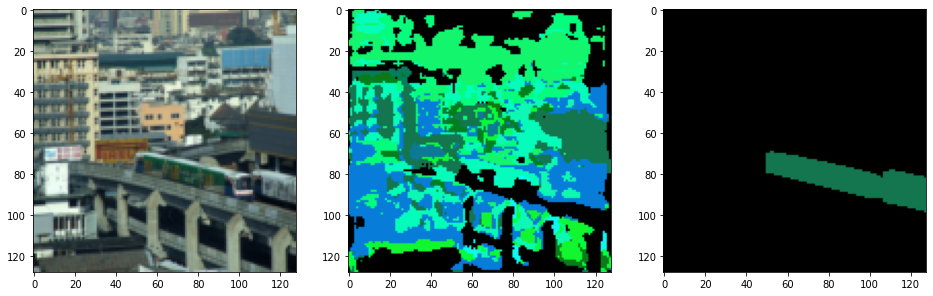

------------------------------ Epoch 55 ------------------------------
Loss: 2.265   Accuracy: 0.303


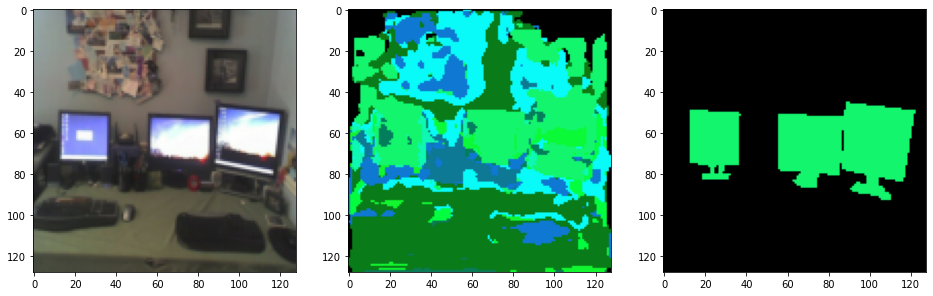

------------------------------ Epoch 56 ------------------------------
Loss: 2.245   Accuracy: 0.272


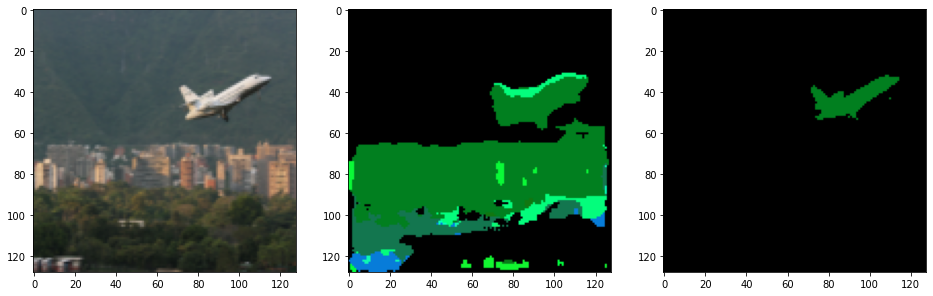

------------------------------ Epoch 57 ------------------------------
Loss: 2.244   Accuracy: 0.295


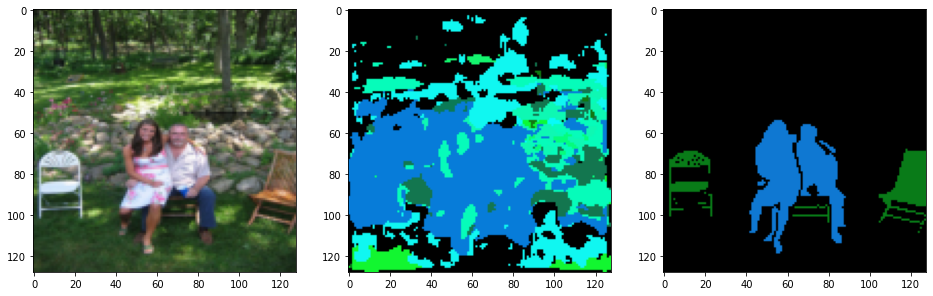

------------------------------ Epoch 58 ------------------------------
Loss: 2.180   Accuracy: 0.298


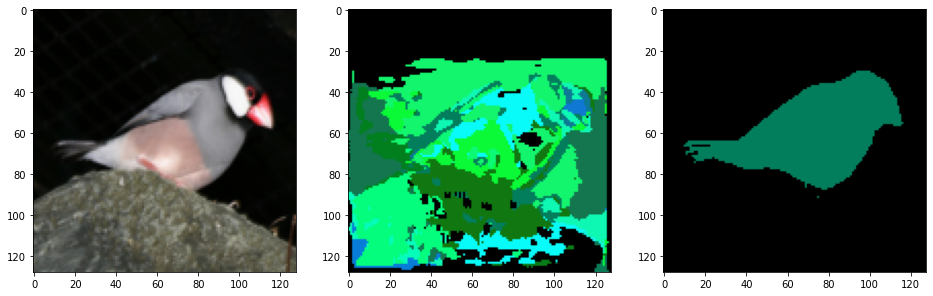

------------------------------ Epoch 59 ------------------------------
Loss: 2.193   Accuracy: 0.302


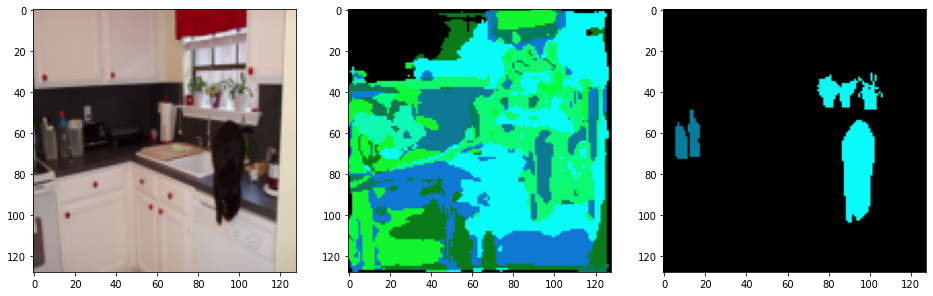

------------------------------ Epoch 60 ------------------------------
Loss: 2.174   Accuracy: 0.294


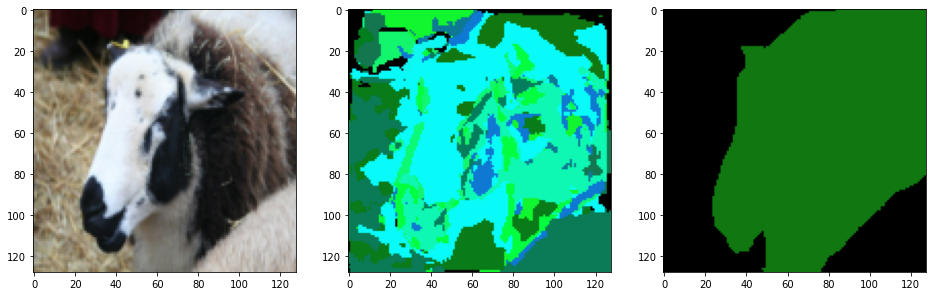

------------------------------ Epoch 61 ------------------------------
Loss: 2.173   Accuracy: 0.300


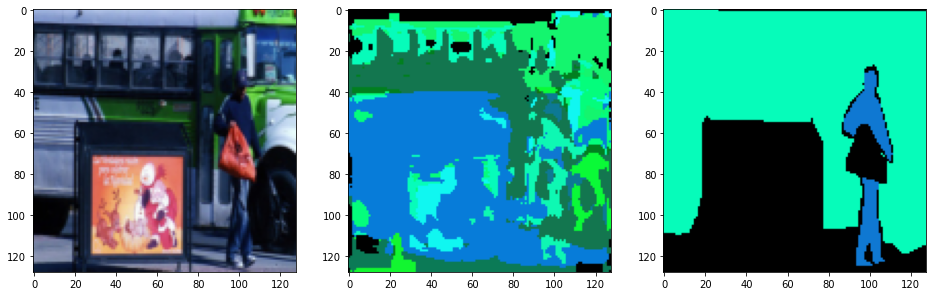

------------------------------ Epoch 62 ------------------------------
Loss: 2.088   Accuracy: 0.289


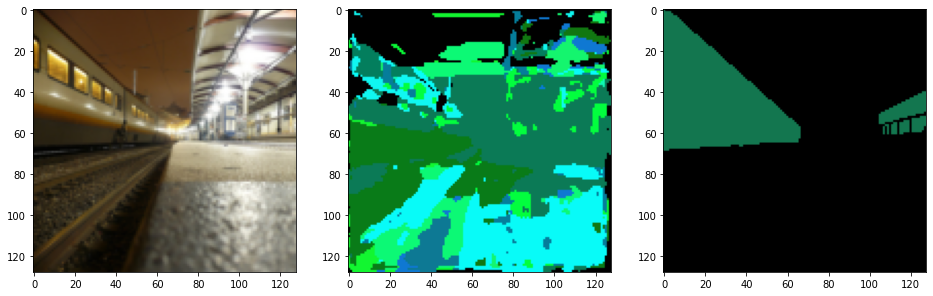

------------------------------ Epoch 63 ------------------------------
Loss: 2.089   Accuracy: 0.293


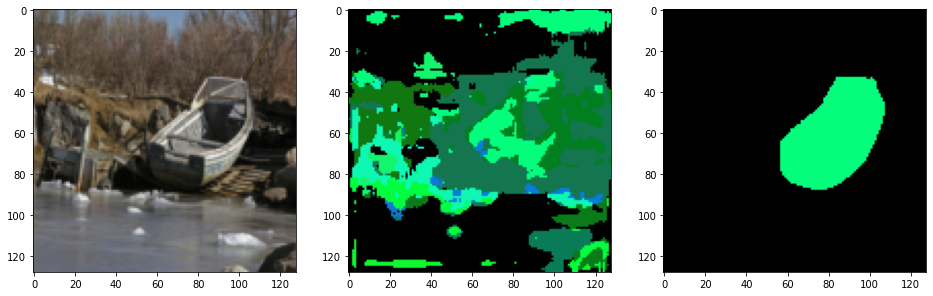

------------------------------ Epoch 64 ------------------------------
Loss: 2.059   Accuracy: 0.305


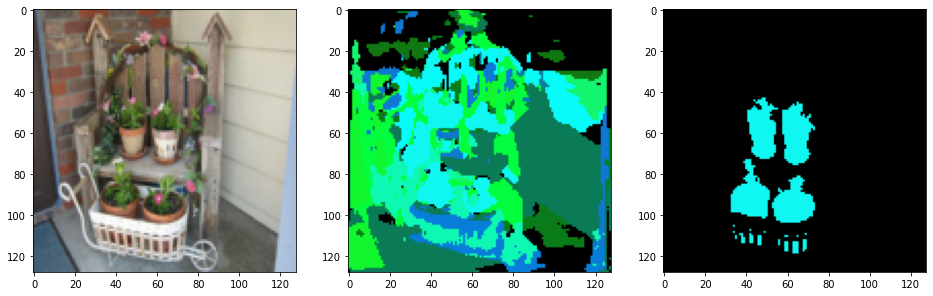

------------------------------ Epoch 65 ------------------------------
Loss: 2.035   Accuracy: 0.312


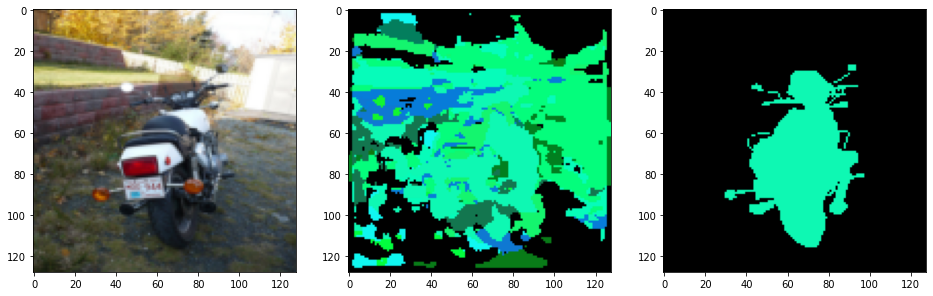

------------------------------ Epoch 66 ------------------------------
Loss: 2.009   Accuracy: 0.303


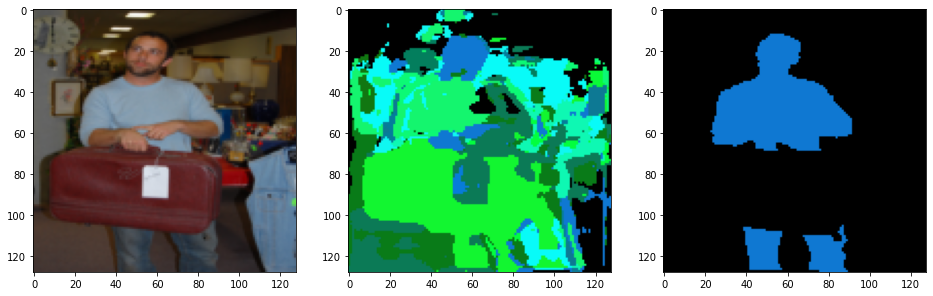

------------------------------ Epoch 67 ------------------------------
Loss: 1.995   Accuracy: 0.320


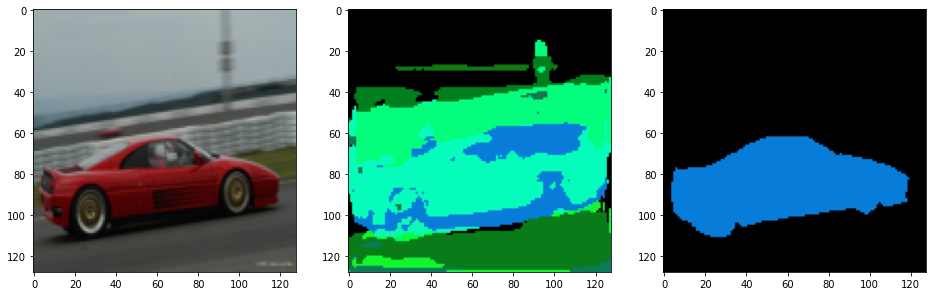

------------------------------ Epoch 68 ------------------------------
Loss: 1.994   Accuracy: 0.314


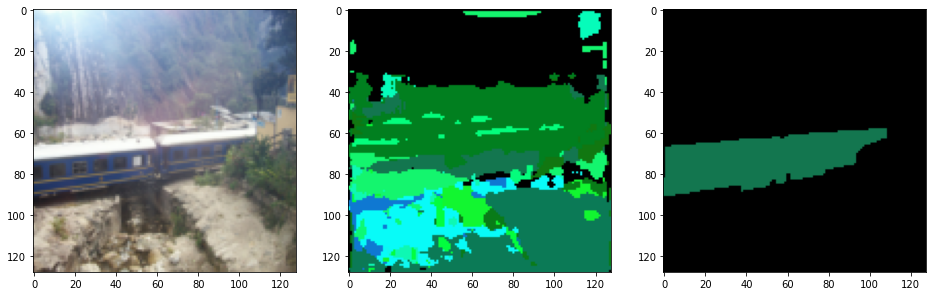

------------------------------ Epoch 69 ------------------------------
Loss: 1.929   Accuracy: 0.313


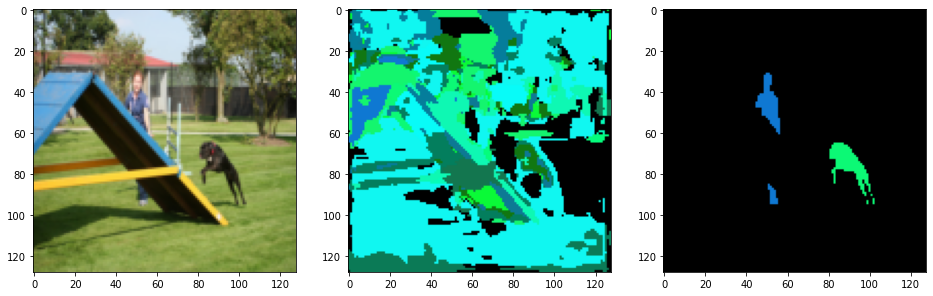

------------------------------ Epoch 70 ------------------------------
Loss: 1.884   Accuracy: 0.322


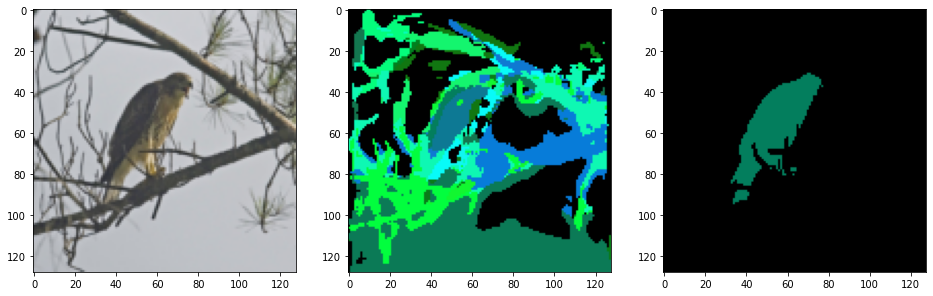

------------------------------ Epoch 71 ------------------------------
Loss: 1.866   Accuracy: 0.312


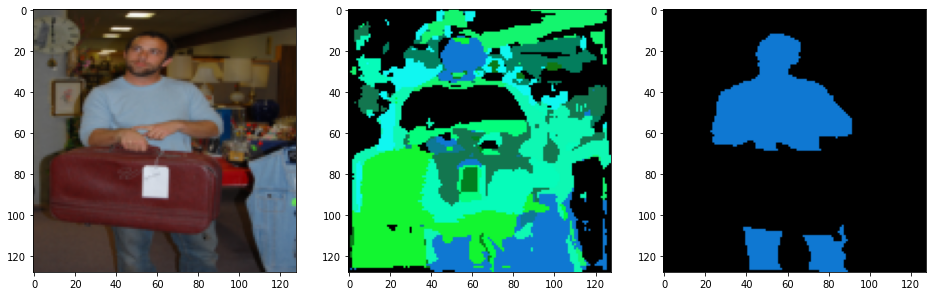

------------------------------ Epoch 72 ------------------------------
Loss: 1.849   Accuracy: 0.332


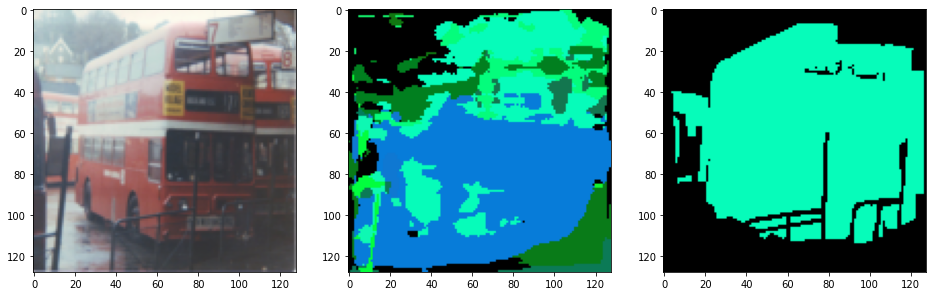

------------------------------ Epoch 73 ------------------------------
Loss: 1.820   Accuracy: 0.321


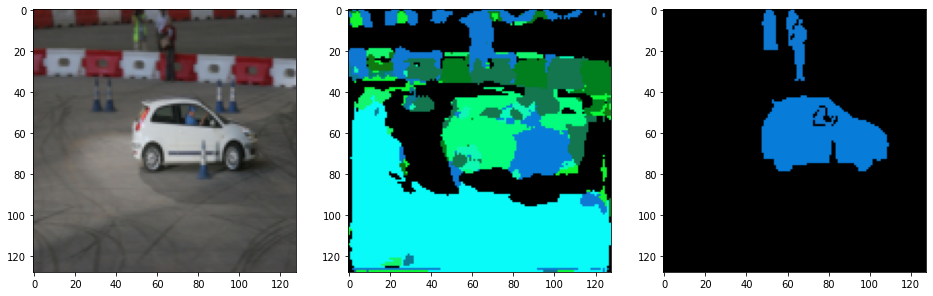

------------------------------ Epoch 74 ------------------------------
Loss: 1.794   Accuracy: 0.341


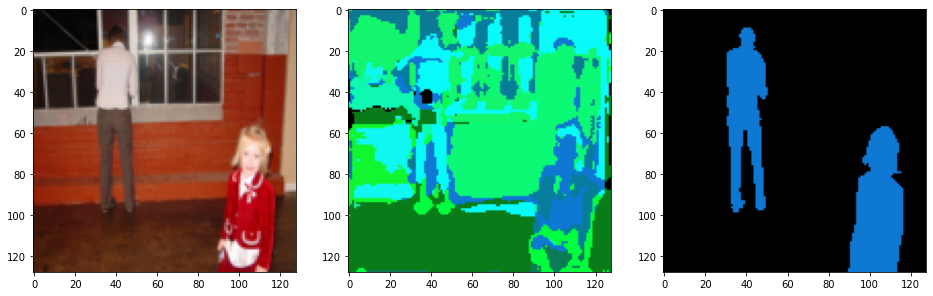

------------------------------ Epoch 75 ------------------------------
Loss: 1.730   Accuracy: 0.328


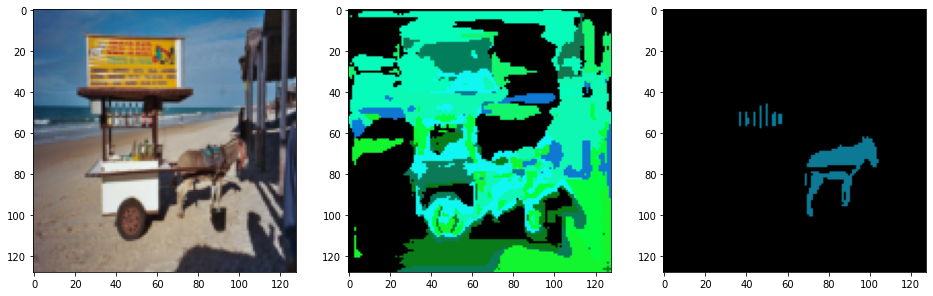

------------------------------ Epoch 76 ------------------------------
Loss: 1.724   Accuracy: 0.344


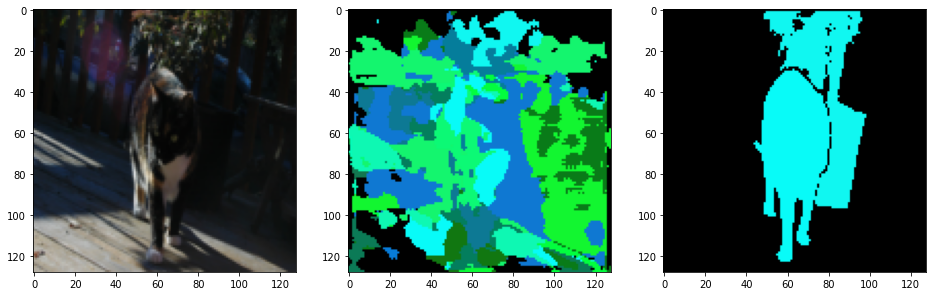

------------------------------ Epoch 77 ------------------------------
Loss: 1.678   Accuracy: 0.347


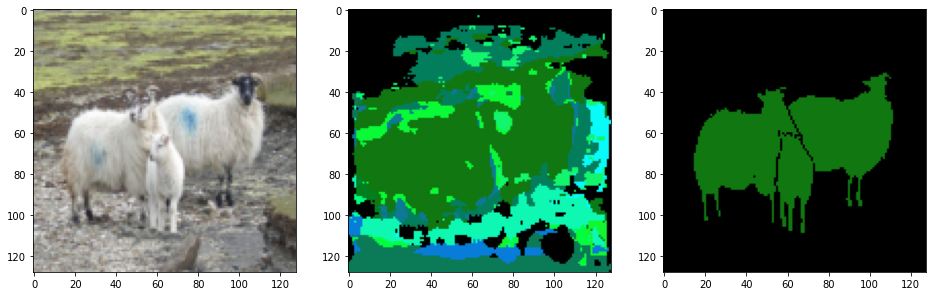

------------------------------ Epoch 78 ------------------------------
Loss: 1.708   Accuracy: 0.333


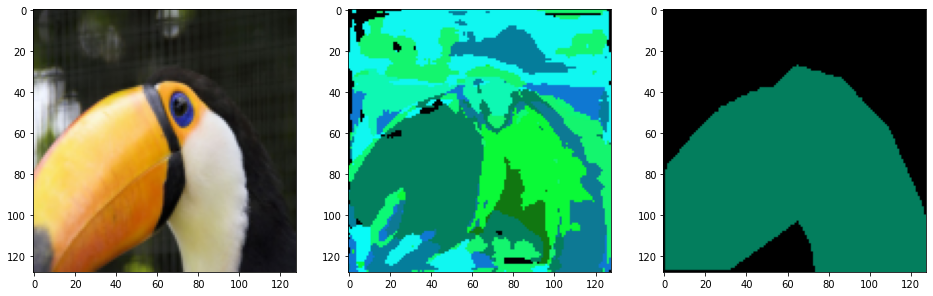

------------------------------ Epoch 79 ------------------------------
Loss: 1.620   Accuracy: 0.335


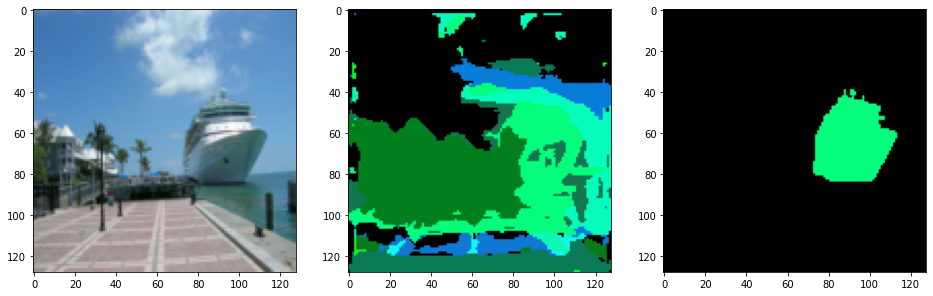

------------------------------ Epoch 80 ------------------------------
Loss: 1.608   Accuracy: 0.348


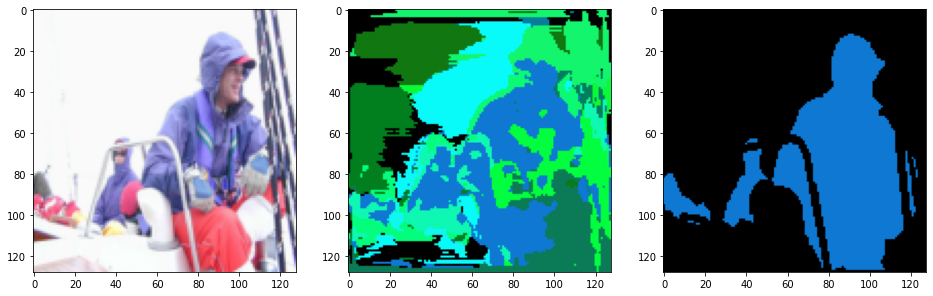

------------------------------ Epoch 81 ------------------------------
Loss: 1.567   Accuracy: 0.355


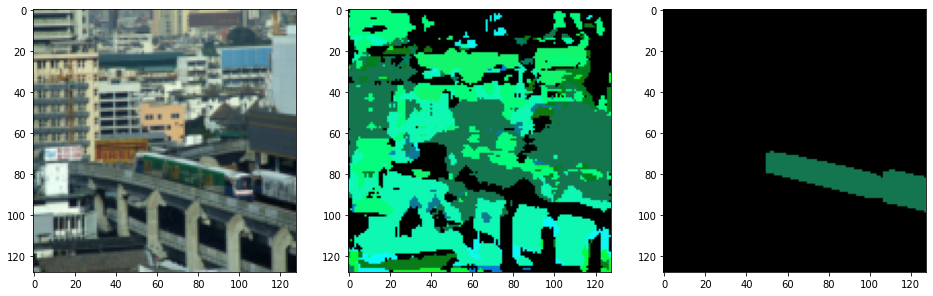

------------------------------ Epoch 82 ------------------------------
Loss: 1.528   Accuracy: 0.351


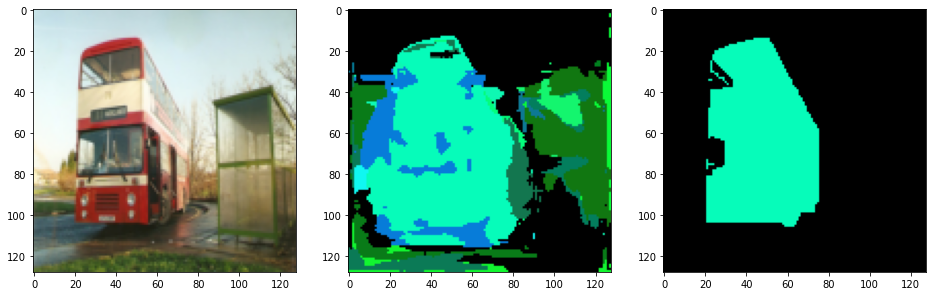

------------------------------ Epoch 83 ------------------------------
Loss: 1.546   Accuracy: 0.355


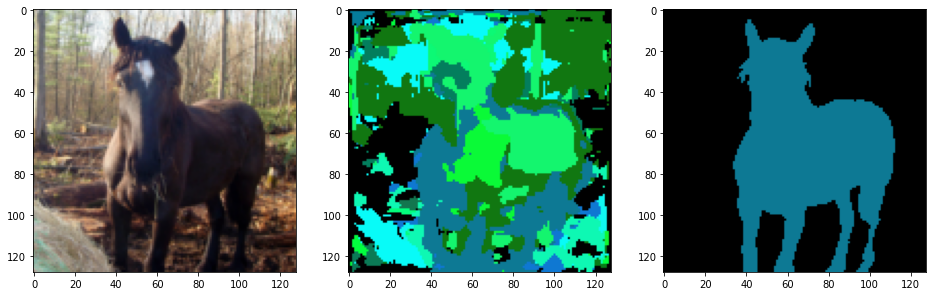

------------------------------ Epoch 84 ------------------------------
Loss: 1.485   Accuracy: 0.353


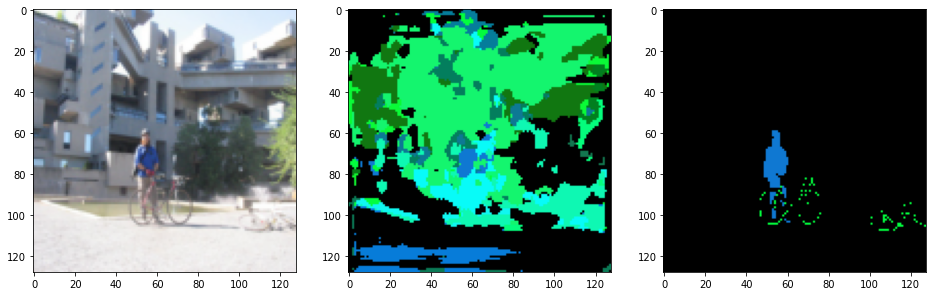

------------------------------ Epoch 85 ------------------------------
Loss: 1.445   Accuracy: 0.363


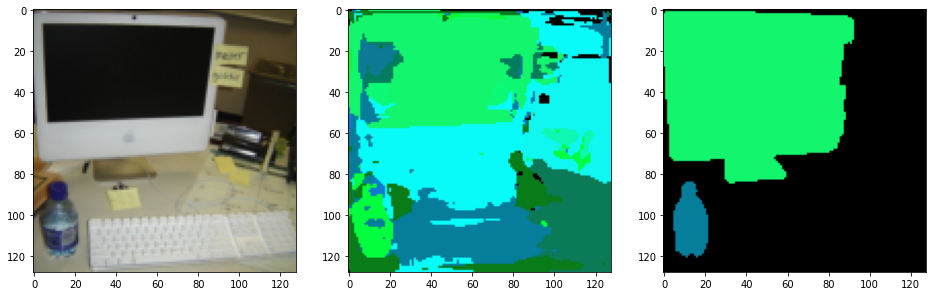

------------------------------ Epoch 86 ------------------------------
Loss: 1.495   Accuracy: 0.346


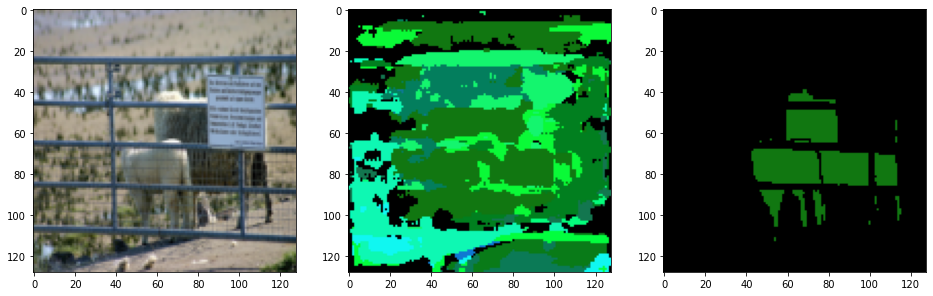

------------------------------ Epoch 87 ------------------------------
Loss: 1.365   Accuracy: 0.365


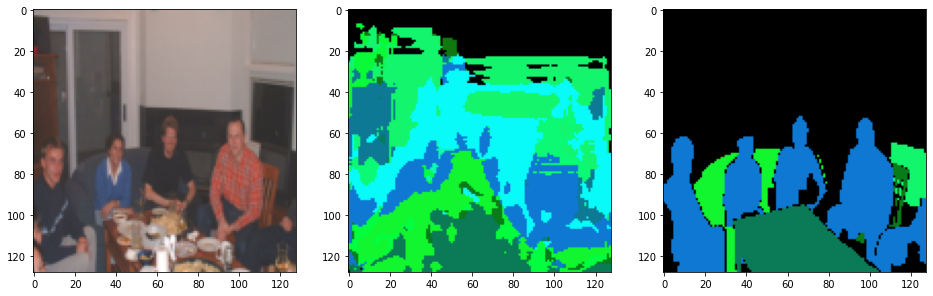

------------------------------ Epoch 88 ------------------------------
Loss: 1.345   Accuracy: 0.377


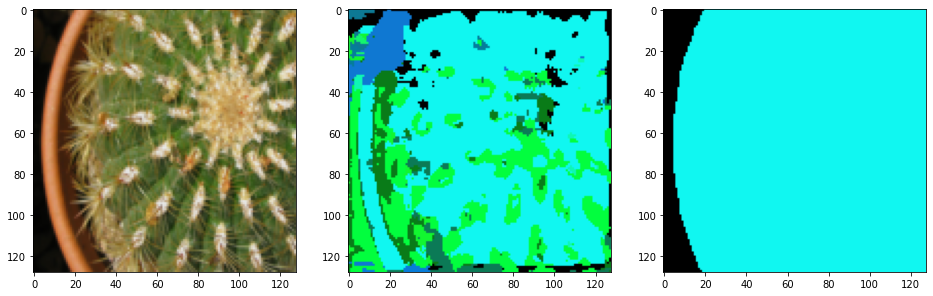

------------------------------ Epoch 89 ------------------------------
Loss: 1.351   Accuracy: 0.365


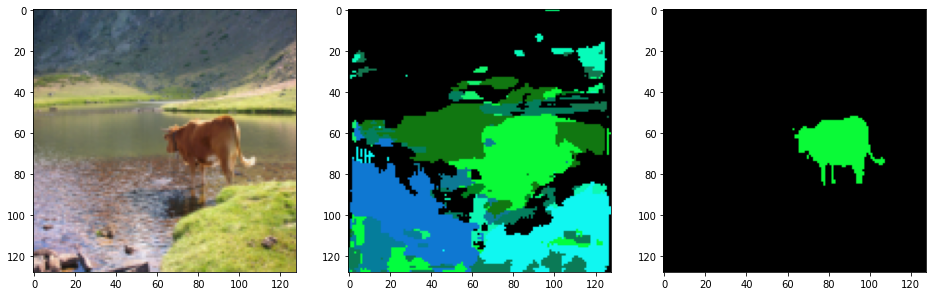

------------------------------ Epoch 90 ------------------------------
Loss: 1.286   Accuracy: 0.385


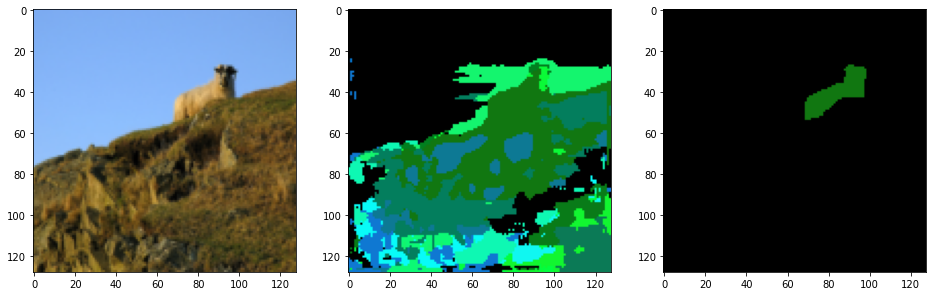

------------------------------ Epoch 91 ------------------------------
Loss: 1.323   Accuracy: 0.369


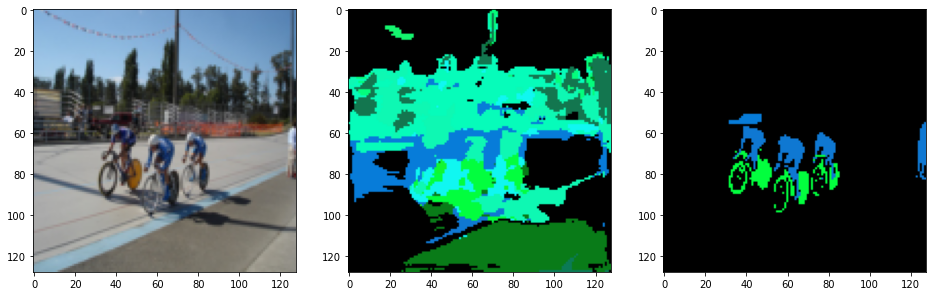

------------------------------ Epoch 92 ------------------------------
Loss: 1.307   Accuracy: 0.375


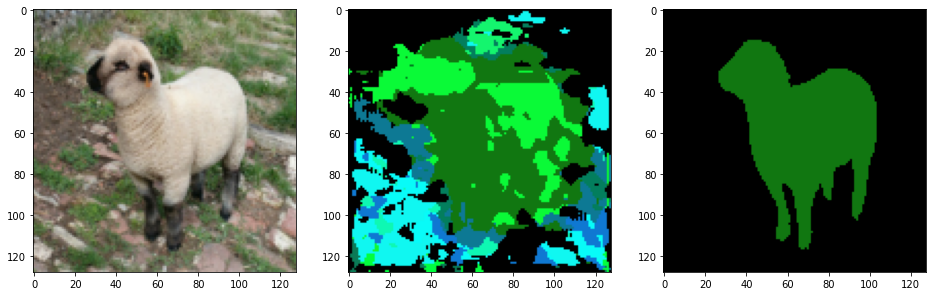

------------------------------ Epoch 93 ------------------------------
Loss: 1.247   Accuracy: 0.383


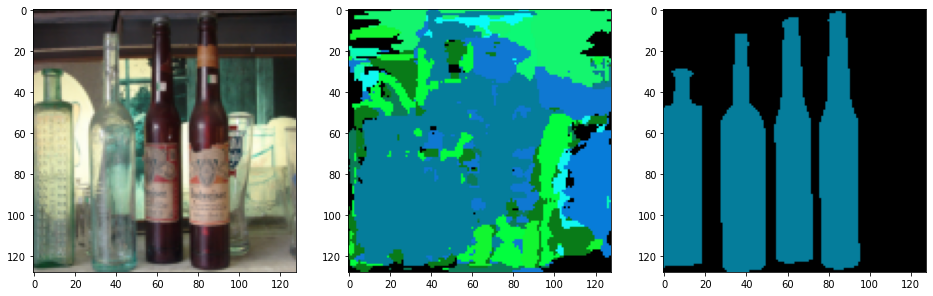

------------------------------ Epoch 94 ------------------------------
Loss: 1.168   Accuracy: 0.395


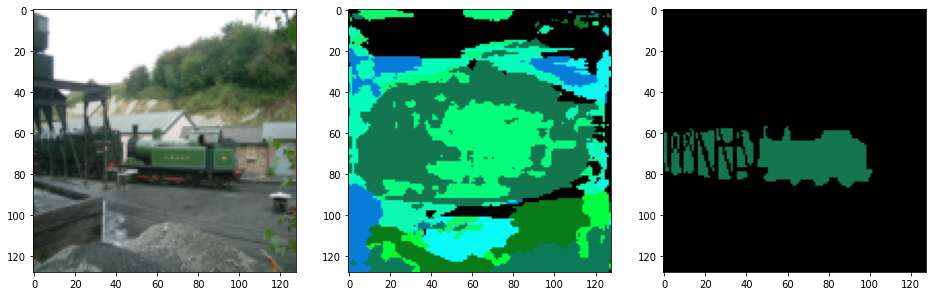

------------------------------ Epoch 95 ------------------------------
Loss: 1.257   Accuracy: 0.374


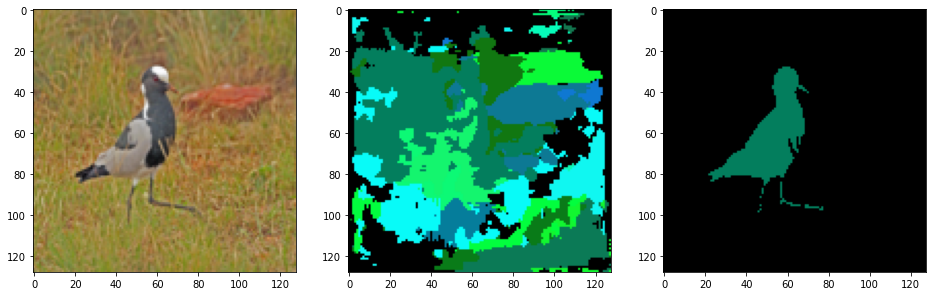

------------------------------ Epoch 96 ------------------------------
Loss: 1.170   Accuracy: 0.372


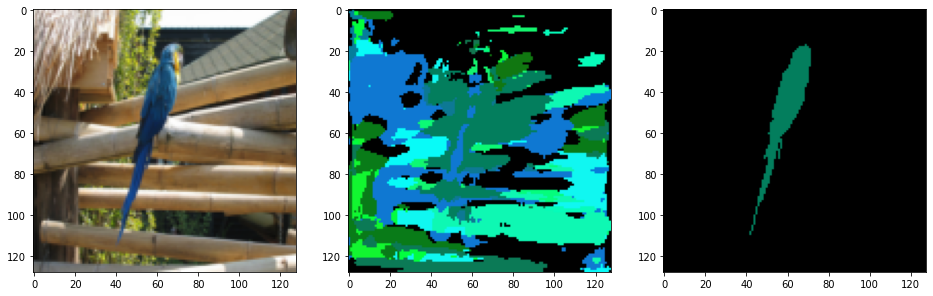

------------------------------ Epoch 97 ------------------------------
Loss: 1.191   Accuracy: 0.405


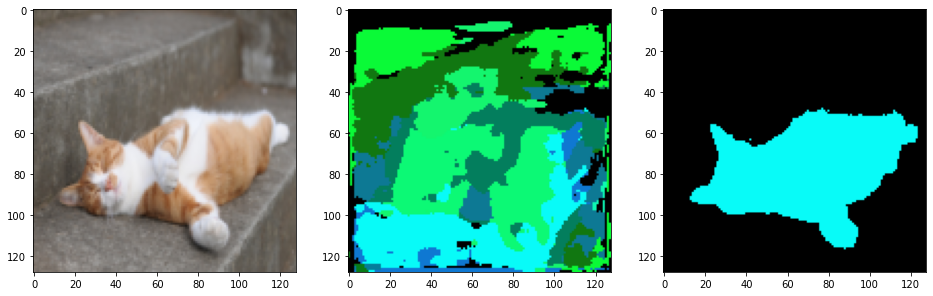

------------------------------ Epoch 98 ------------------------------
Loss: 1.098   Accuracy: 0.404


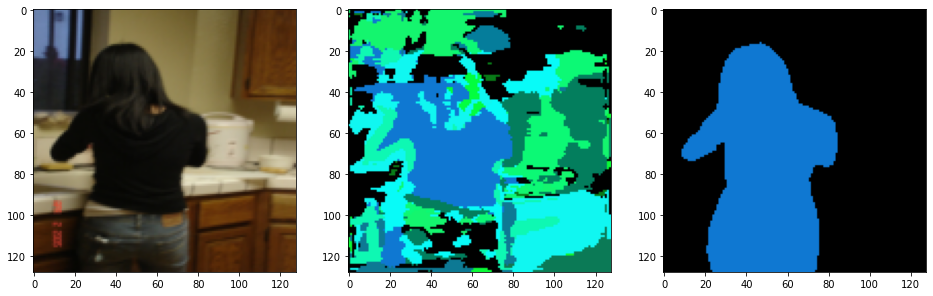

------------------------------ Epoch 99 ------------------------------
Loss: 1.060   Accuracy: 0.415


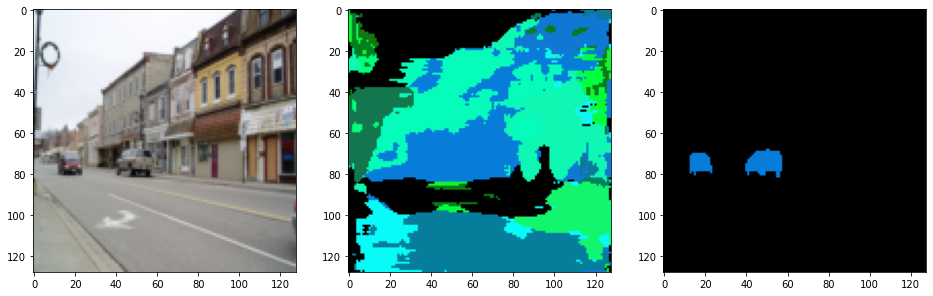

------------------------------ Epoch 100 ------------------------------
Loss: 1.106   Accuracy: 0.418


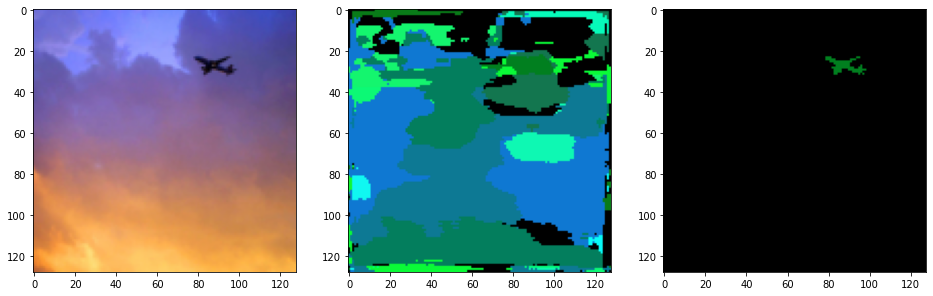

------------------------------ Epoch 101 ------------------------------
Loss: 1.039   Accuracy: 0.403


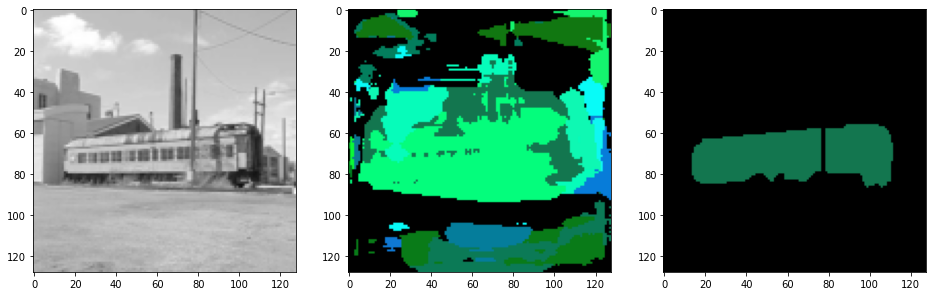

------------------------------ Epoch 102 ------------------------------
Loss: 1.085   Accuracy: 0.405


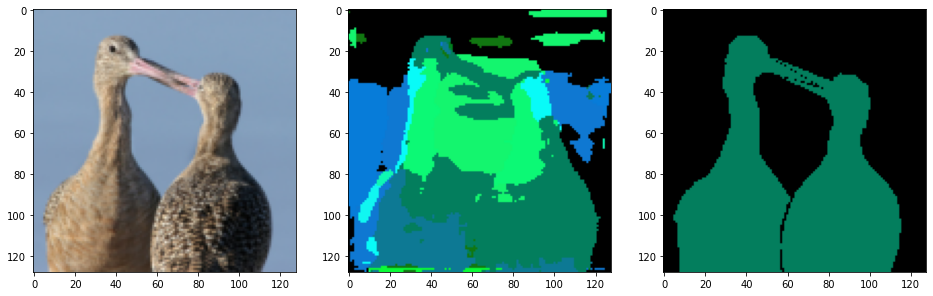

------------------------------ Epoch 103 ------------------------------
Loss: 0.992   Accuracy: 0.420


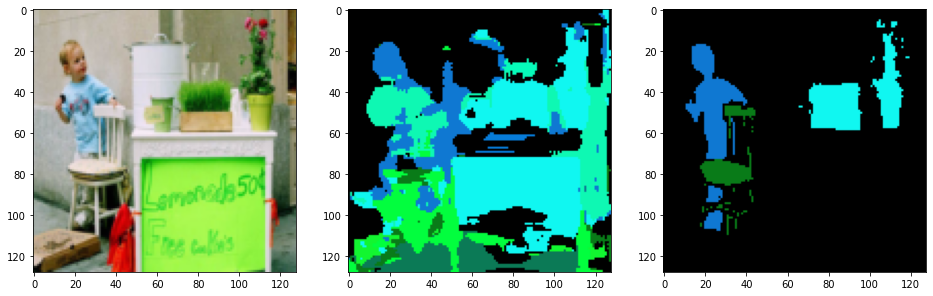

------------------------------ Epoch 104 ------------------------------
Loss: 1.022   Accuracy: 0.427


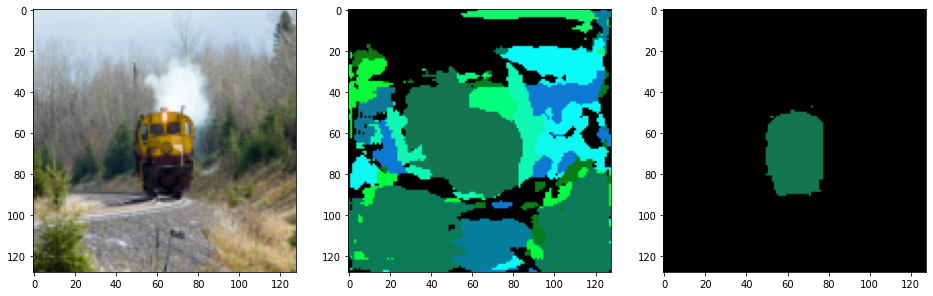

------------------------------ Epoch 105 ------------------------------
Loss: 1.018   Accuracy: 0.430


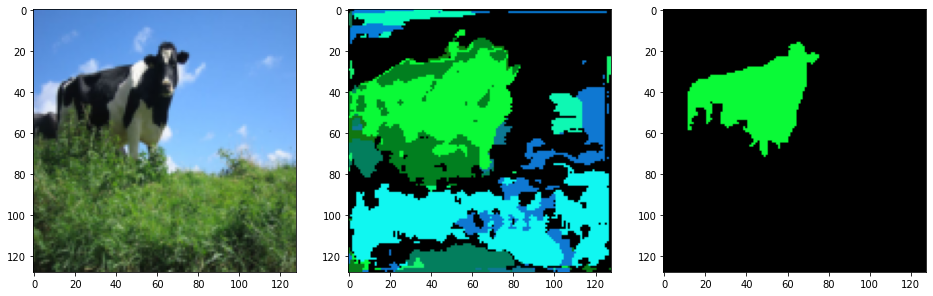

------------------------------ Epoch 106 ------------------------------
Loss: 0.944   Accuracy: 0.432


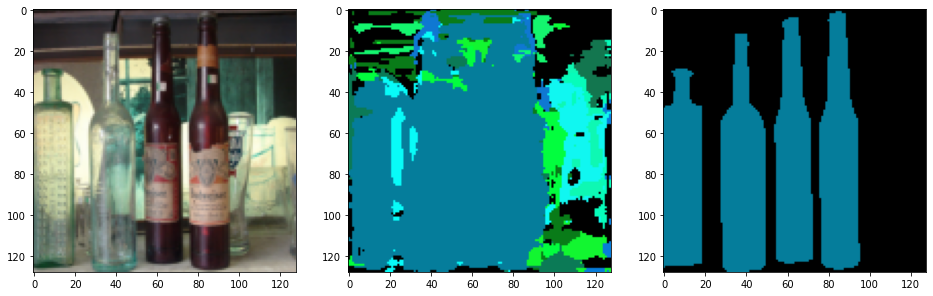

------------------------------ Epoch 107 ------------------------------
Loss: 0.895   Accuracy: 0.443


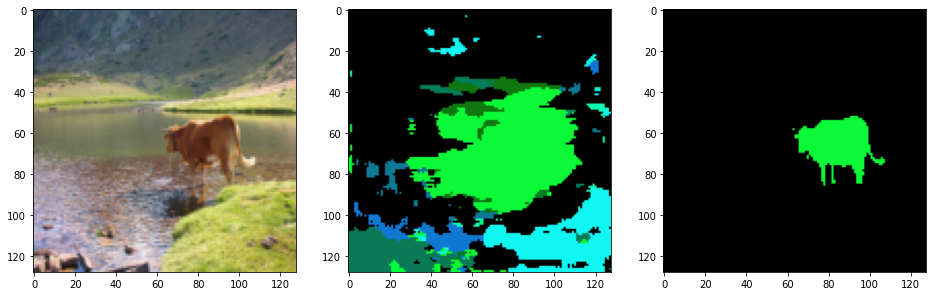

------------------------------ Epoch 108 ------------------------------
Loss: 0.853   Accuracy: 0.459


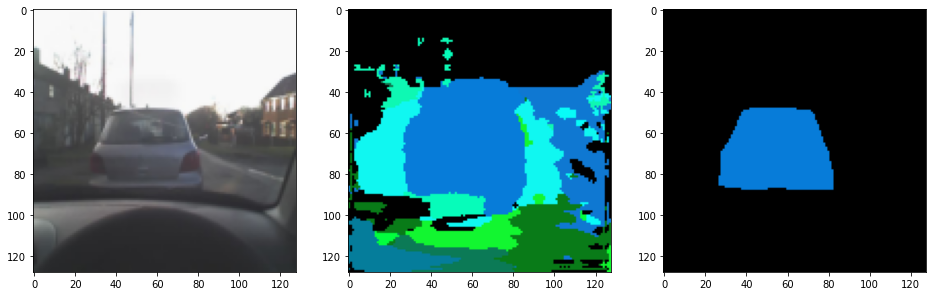

------------------------------ Epoch 109 ------------------------------
Loss: 0.891   Accuracy: 0.459


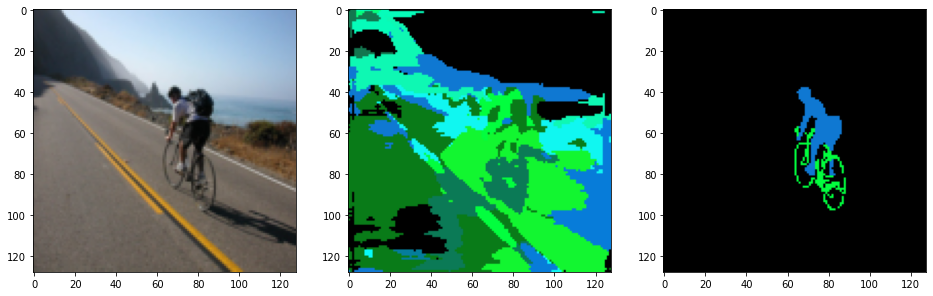

------------------------------ Epoch 110 ------------------------------
Loss: 0.881   Accuracy: 0.449


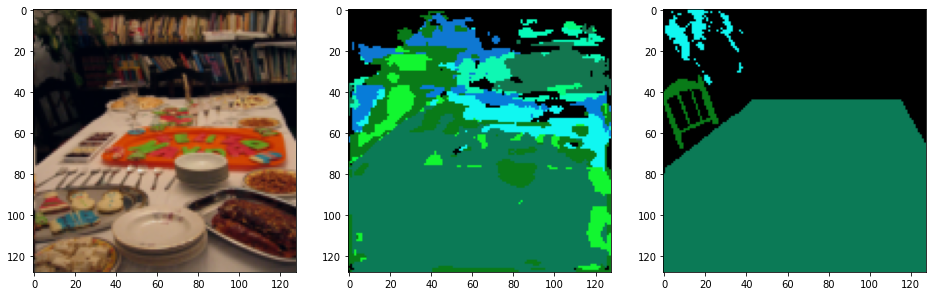

------------------------------ Epoch 111 ------------------------------
Loss: 0.889   Accuracy: 0.457


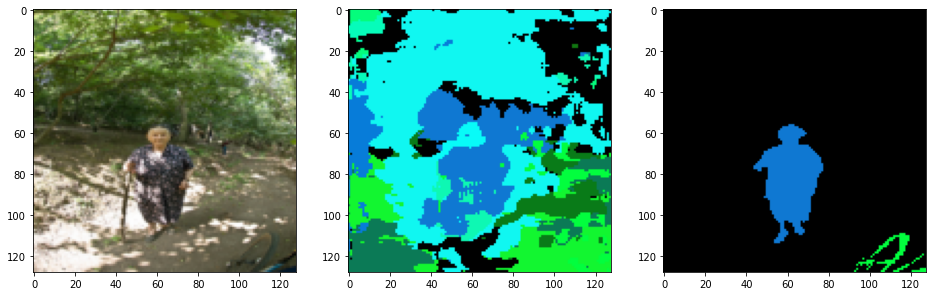

------------------------------ Epoch 112 ------------------------------
Loss: 0.820   Accuracy: 0.469


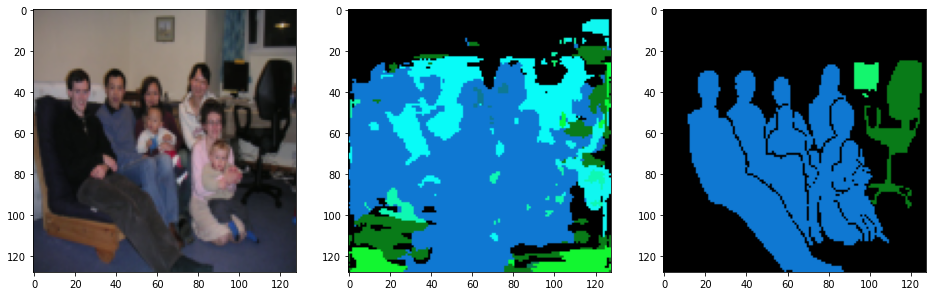

------------------------------ Epoch 113 ------------------------------
Loss: 0.744   Accuracy: 0.484


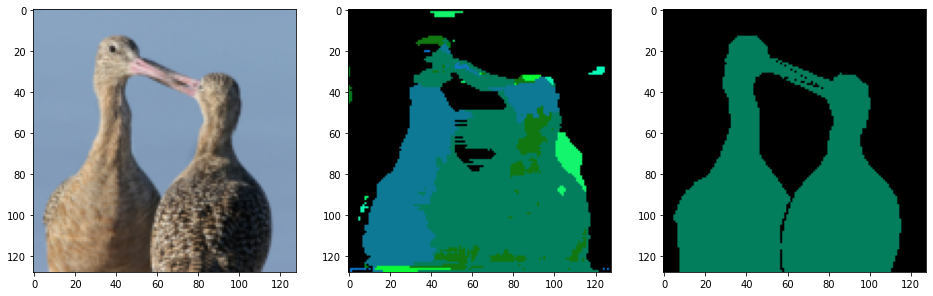

------------------------------ Epoch 114 ------------------------------
Loss: 0.765   Accuracy: 0.474


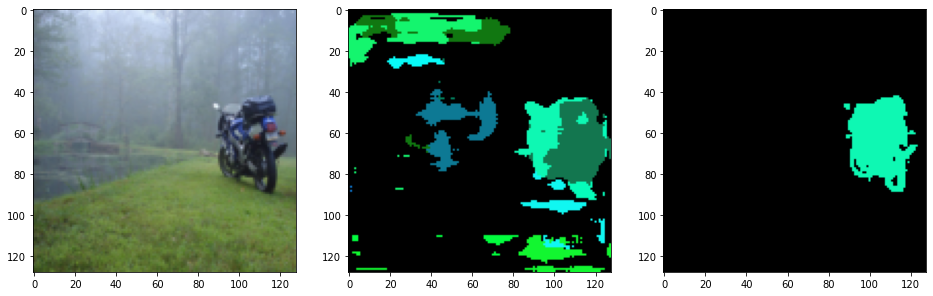

------------------------------ Epoch 115 ------------------------------
Loss: 0.867   Accuracy: 0.468


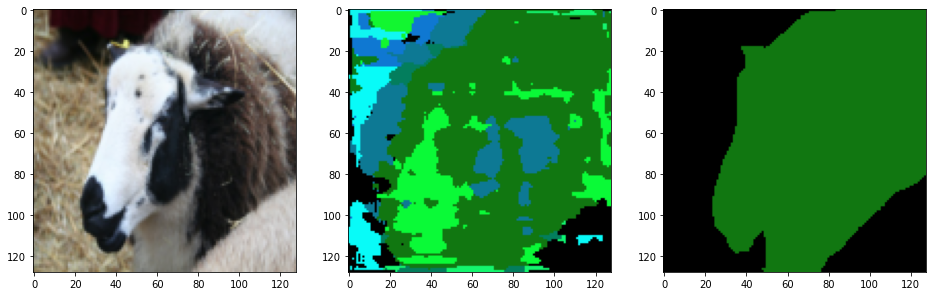

------------------------------ Epoch 116 ------------------------------
Loss: 0.717   Accuracy: 0.488


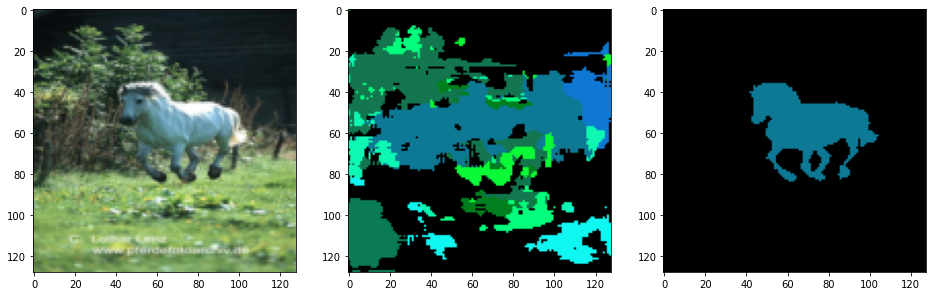

------------------------------ Epoch 117 ------------------------------
Loss: 0.706   Accuracy: 0.502


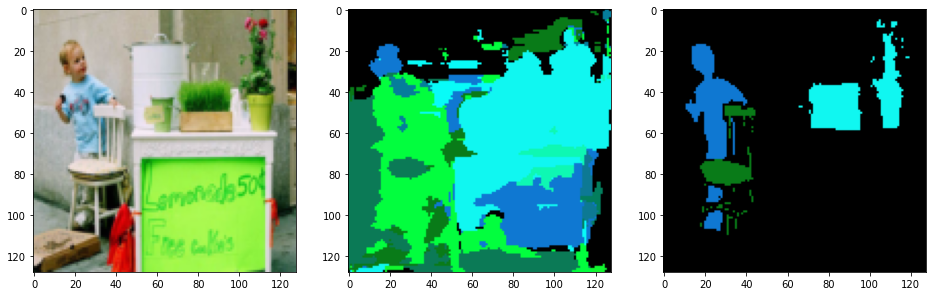

------------------------------ Epoch 118 ------------------------------
Loss: 0.735   Accuracy: 0.495


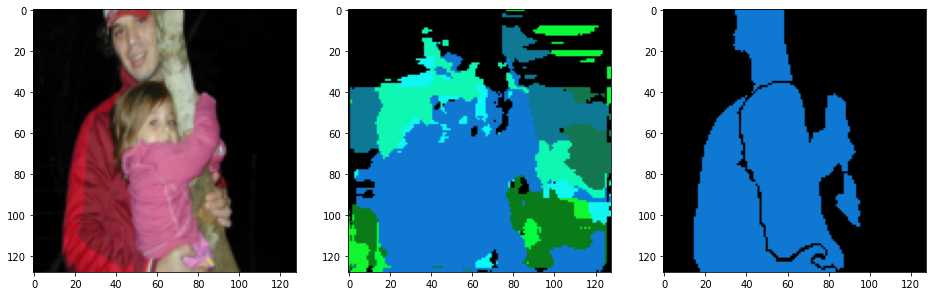

------------------------------ Epoch 119 ------------------------------
Loss: 0.790   Accuracy: 0.482


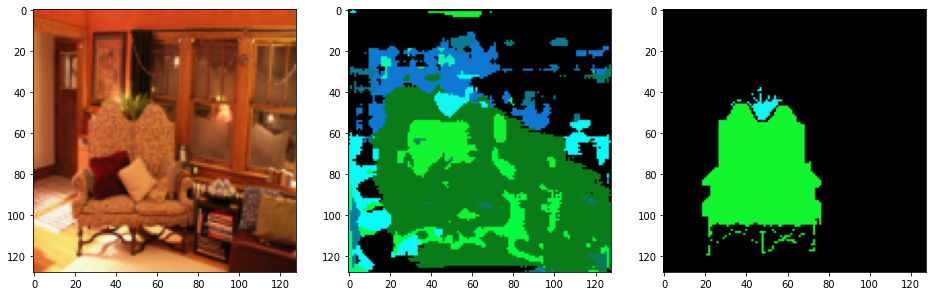

------------------------------ Epoch 120 ------------------------------
Loss: 0.673   Accuracy: 0.506


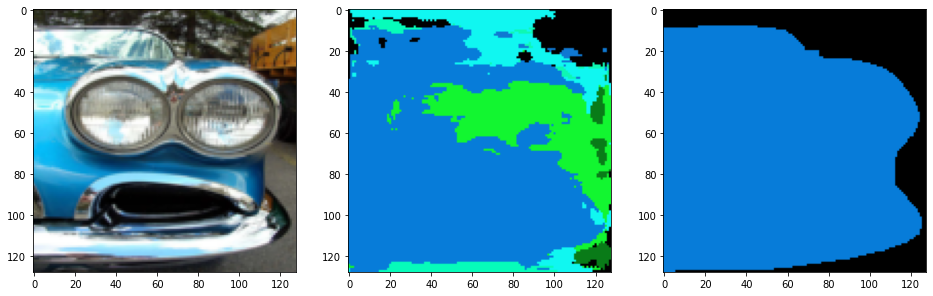

------------------------------ Epoch 121 ------------------------------
Loss: 0.631   Accuracy: 0.528


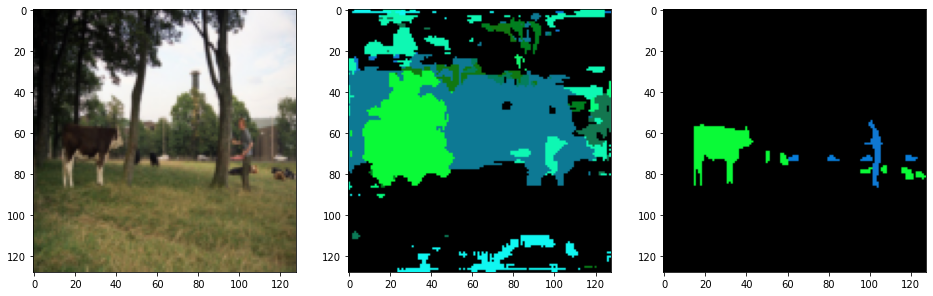

------------------------------ Epoch 122 ------------------------------
Loss: 0.626   Accuracy: 0.524


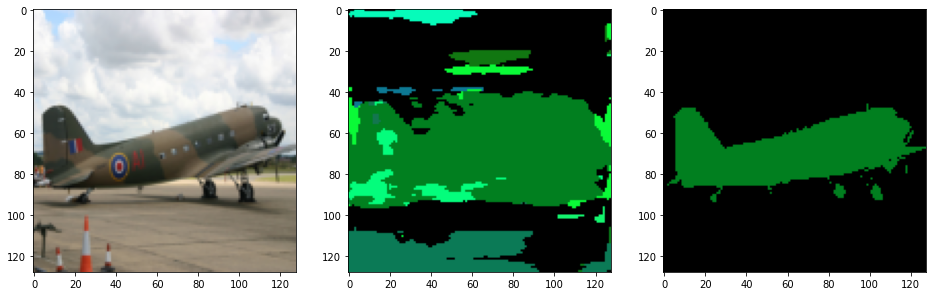

------------------------------ Epoch 123 ------------------------------
Loss: 0.643   Accuracy: 0.528


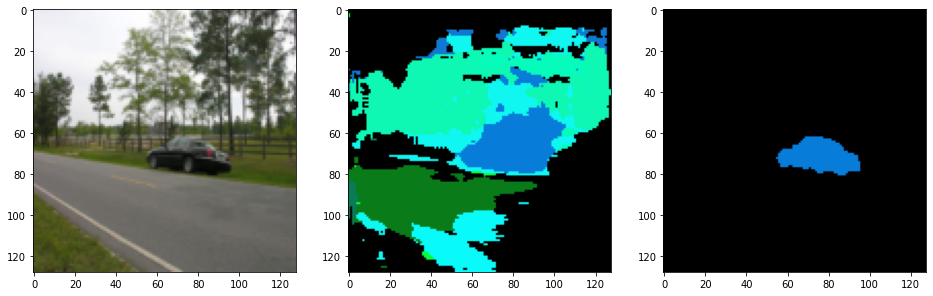

------------------------------ Epoch 124 ------------------------------
Loss: 0.632   Accuracy: 0.538


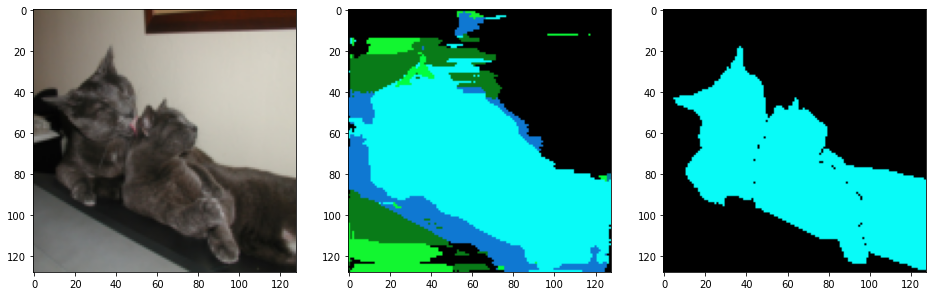

------------------------------ Epoch 125 ------------------------------
Loss: 0.561   Accuracy: 0.548


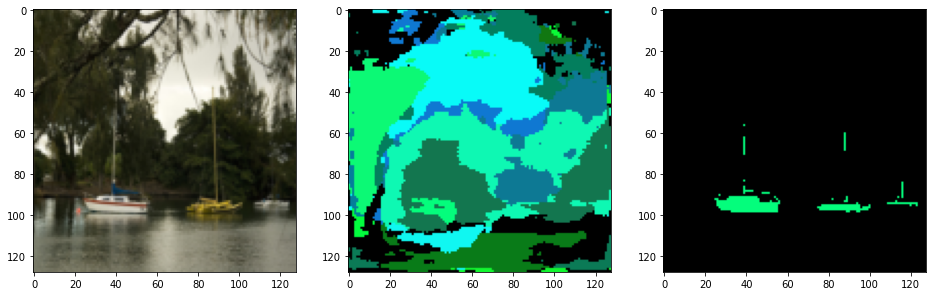

------------------------------ Epoch 126 ------------------------------
Loss: 0.622   Accuracy: 0.538


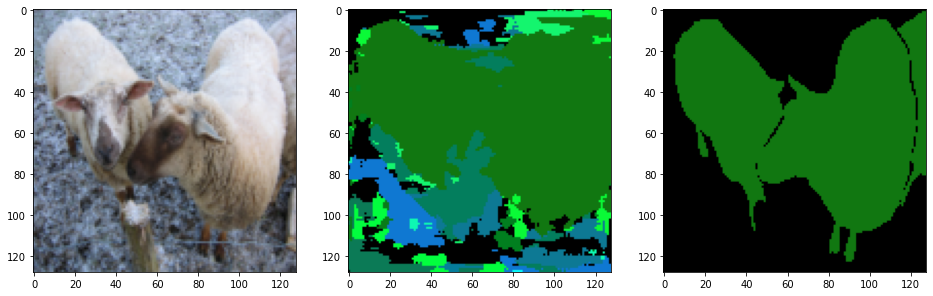

------------------------------ Epoch 127 ------------------------------
Loss: 0.609   Accuracy: 0.543


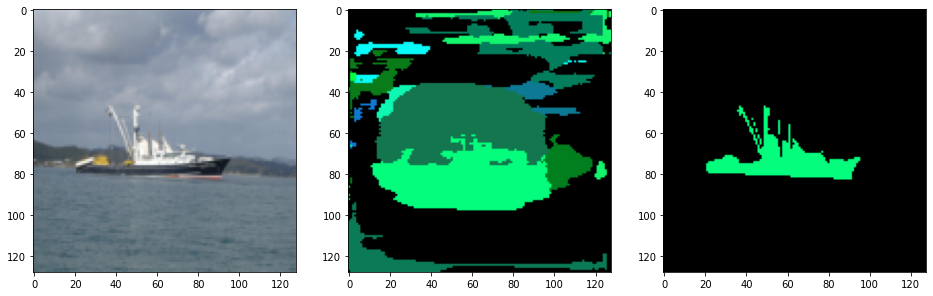

------------------------------ Epoch 128 ------------------------------
Loss: 0.528   Accuracy: 0.558


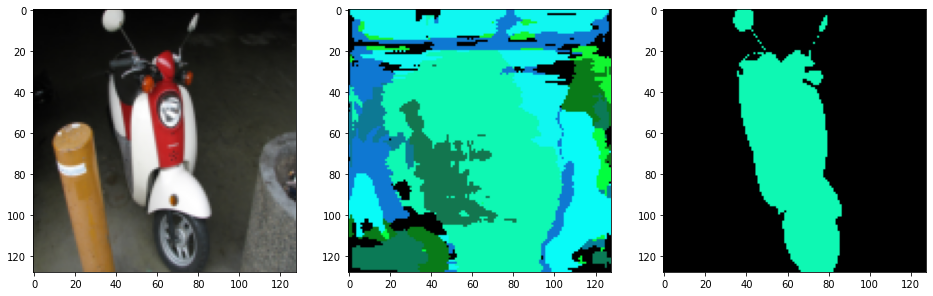

------------------------------ Epoch 129 ------------------------------
Loss: 0.551   Accuracy: 0.564


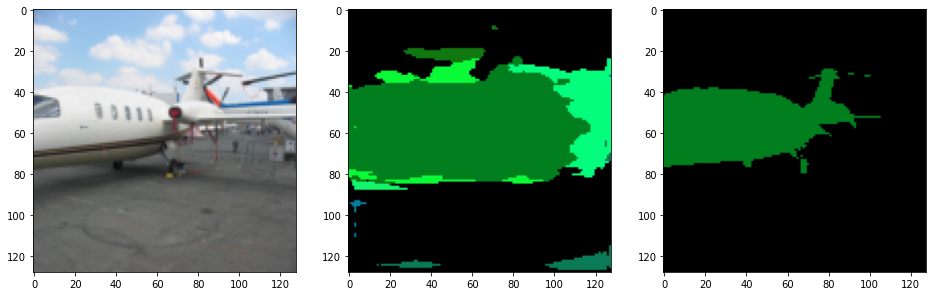

------------------------------ Epoch 130 ------------------------------
Loss: 0.520   Accuracy: 0.562


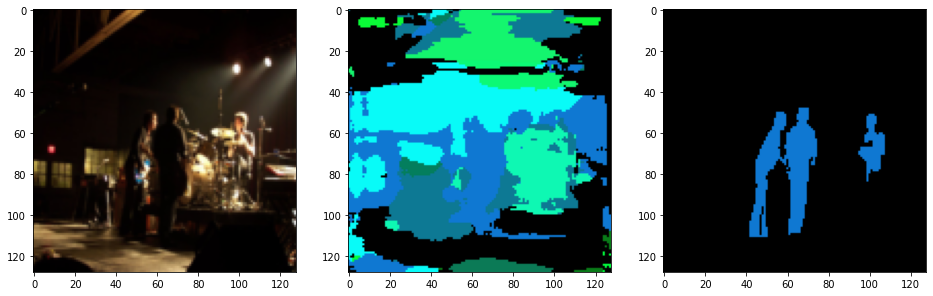

------------------------------ Epoch 131 ------------------------------
Loss: 0.512   Accuracy: 0.572


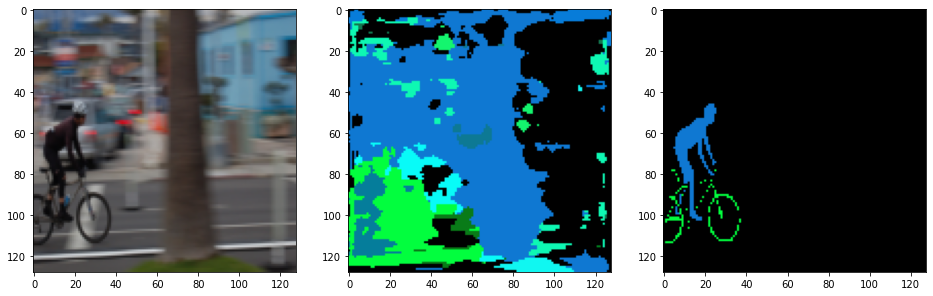

------------------------------ Epoch 132 ------------------------------
Loss: 0.451   Accuracy: 0.591


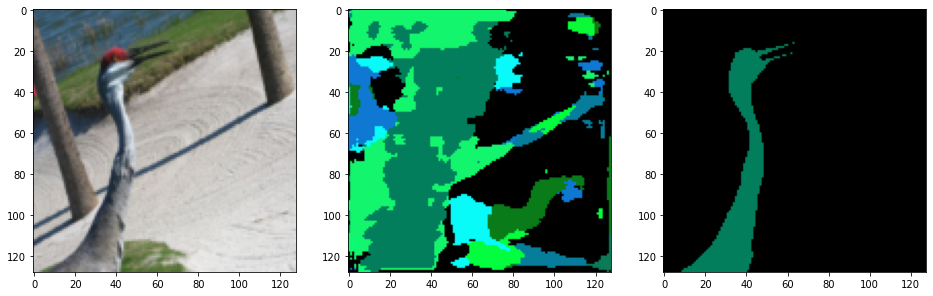

------------------------------ Epoch 133 ------------------------------
Loss: 0.589   Accuracy: 0.562


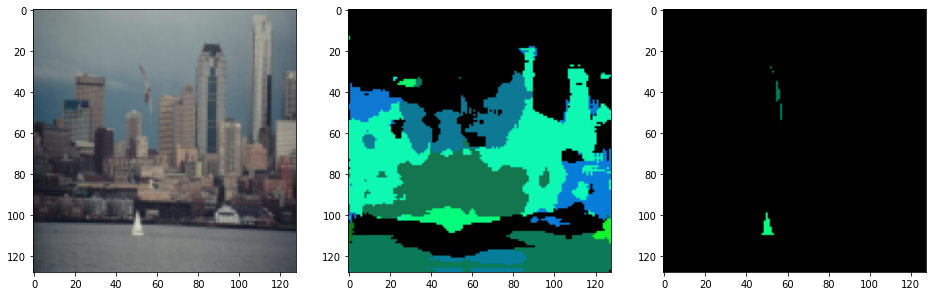

------------------------------ Epoch 134 ------------------------------
Loss: 0.566   Accuracy: 0.559


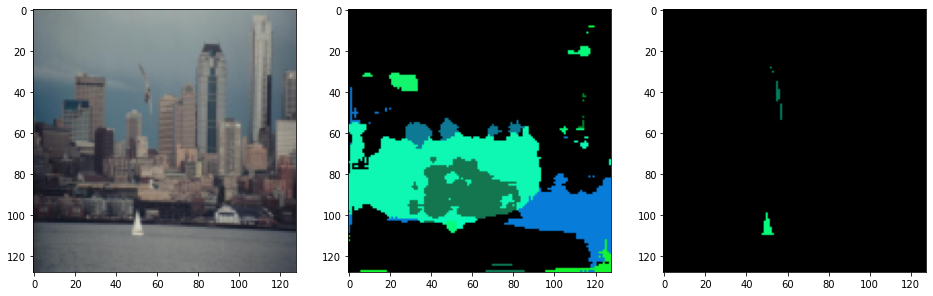

------------------------------ Epoch 135 ------------------------------
Loss: 0.581   Accuracy: 0.554


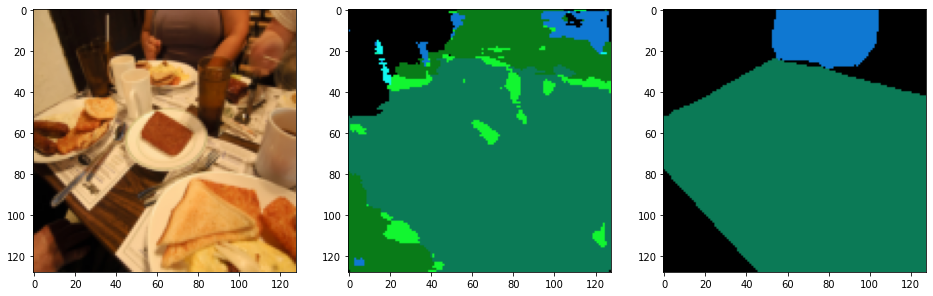

------------------------------ Epoch 136 ------------------------------
Loss: 0.481   Accuracy: 0.593


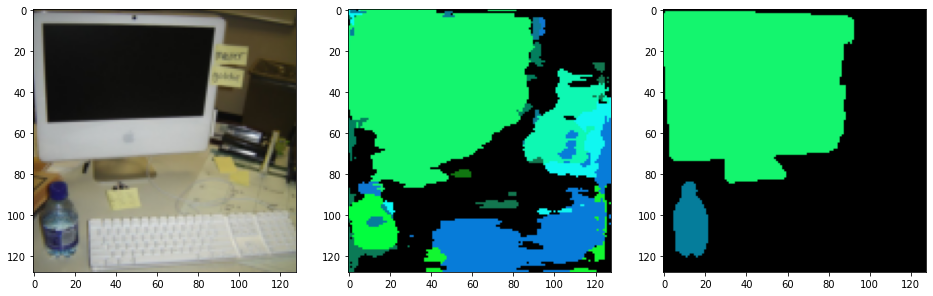

------------------------------ Epoch 137 ------------------------------
Loss: 0.539   Accuracy: 0.573


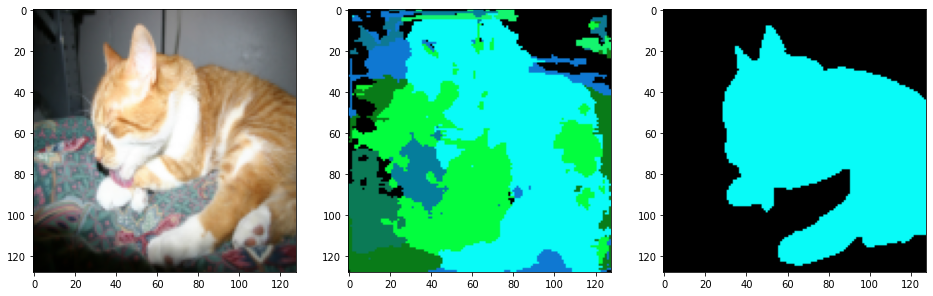

------------------------------ Epoch 138 ------------------------------
Loss: 0.485   Accuracy: 0.589


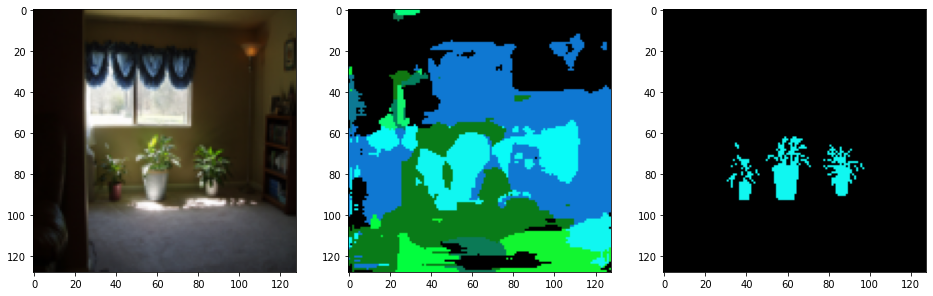

------------------------------ Epoch 139 ------------------------------
Loss: 0.539   Accuracy: 0.583


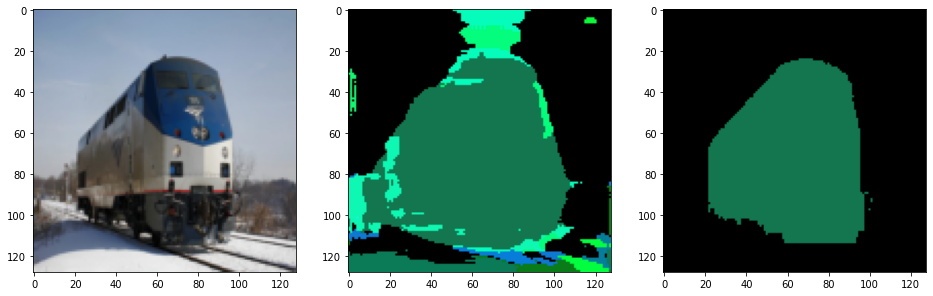

------------------------------ Epoch 140 ------------------------------
Loss: 0.456   Accuracy: 0.602


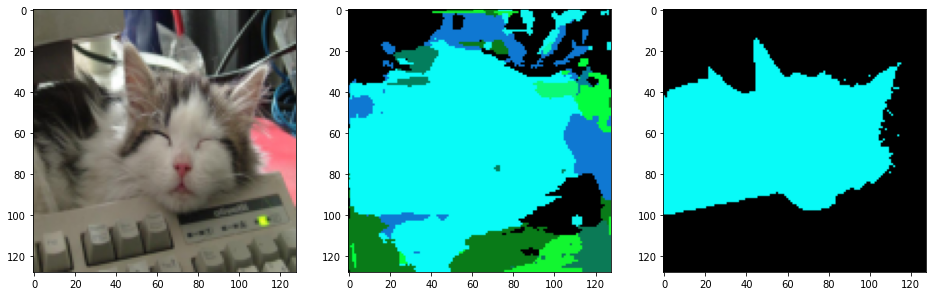

------------------------------ Epoch 141 ------------------------------
Loss: 0.357   Accuracy: 0.620


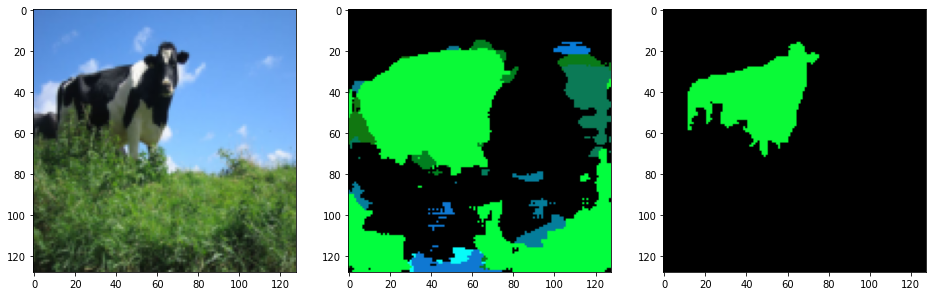

------------------------------ Epoch 142 ------------------------------
Loss: 0.353   Accuracy: 0.629


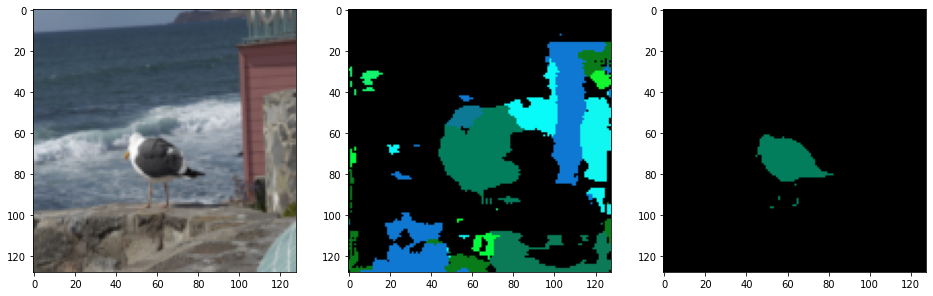

------------------------------ Epoch 143 ------------------------------
Loss: 0.360   Accuracy: 0.642


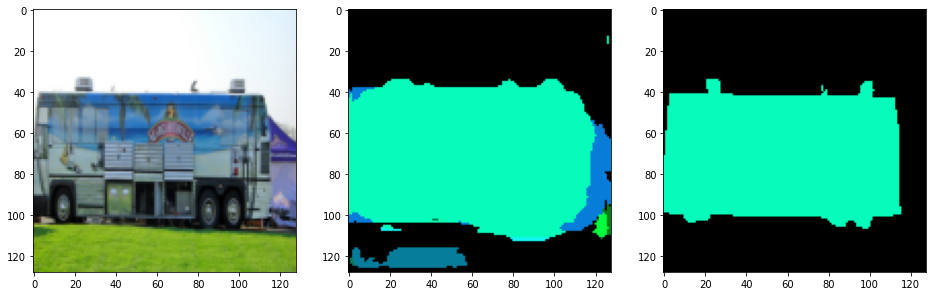

------------------------------ Epoch 144 ------------------------------
Loss: 0.347   Accuracy: 0.636


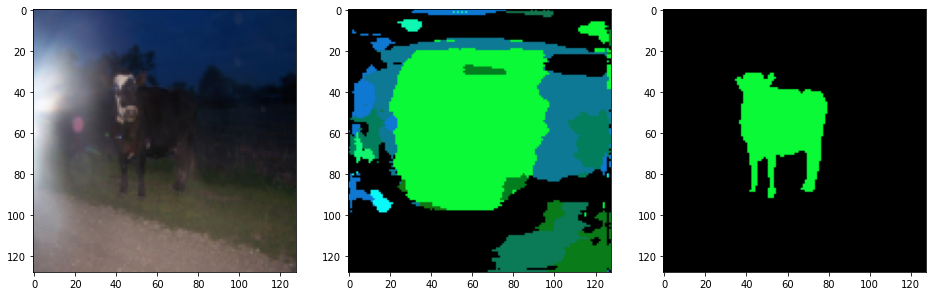

------------------------------ Epoch 145 ------------------------------
Loss: 0.359   Accuracy: 0.642


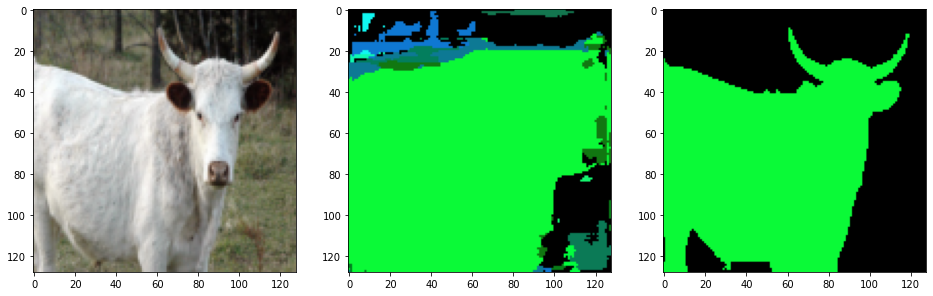

------------------------------ Epoch 146 ------------------------------
Loss: 0.432   Accuracy: 0.625


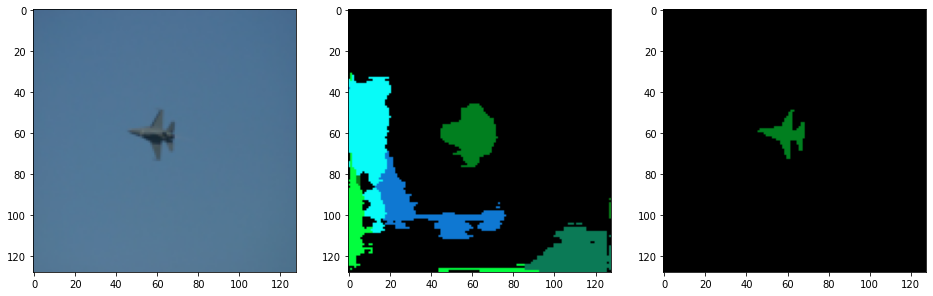

------------------------------ Epoch 147 ------------------------------
Loss: 0.458   Accuracy: 0.607


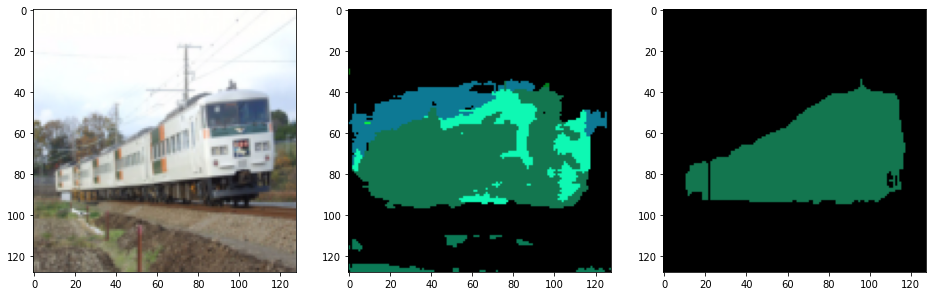

------------------------------ Epoch 148 ------------------------------
Loss: 0.417   Accuracy: 0.620


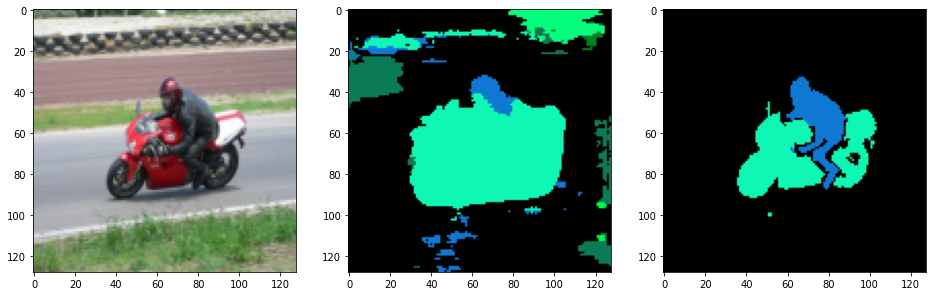

------------------------------ Epoch 149 ------------------------------
Loss: 0.408   Accuracy: 0.634


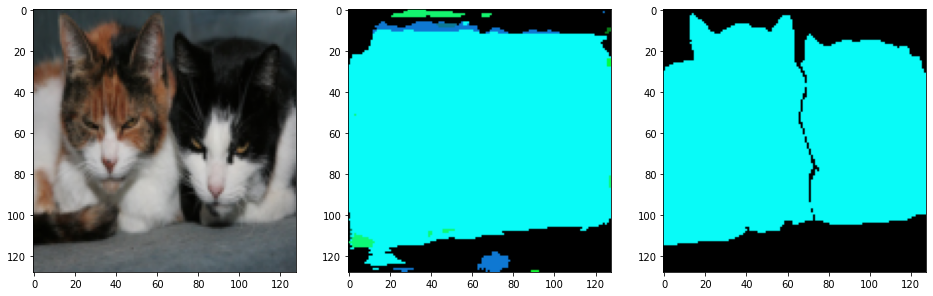

------------------------------ Epoch 150 ------------------------------
Loss: 0.426   Accuracy: 0.640


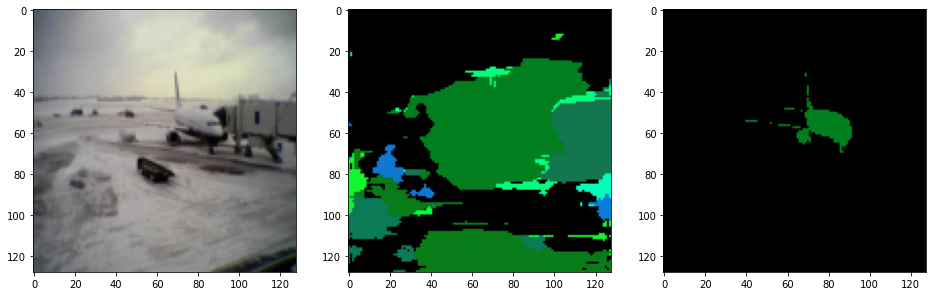

------------------------------ Epoch 151 ------------------------------
Loss: 0.423   Accuracy: 0.628


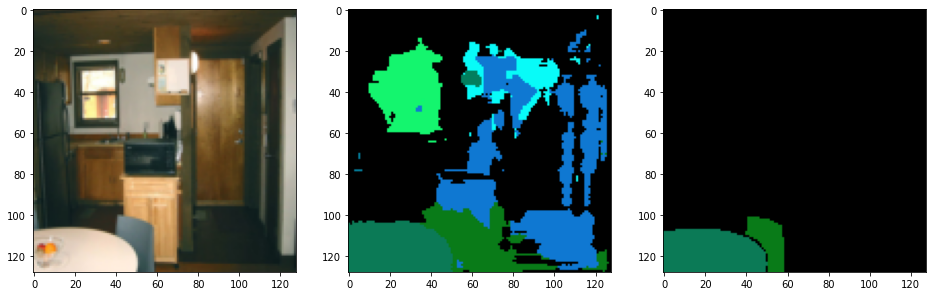

------------------------------ Epoch 152 ------------------------------
Loss: 0.347   Accuracy: 0.656


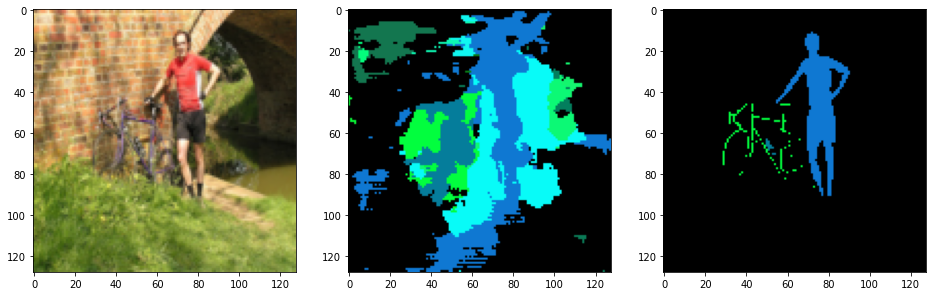

------------------------------ Epoch 153 ------------------------------
Loss: 0.317   Accuracy: 0.658


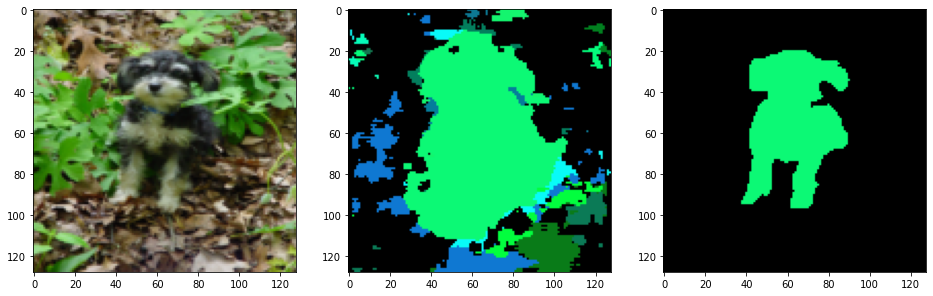

------------------------------ Epoch 154 ------------------------------
Loss: 0.303   Accuracy: 0.673


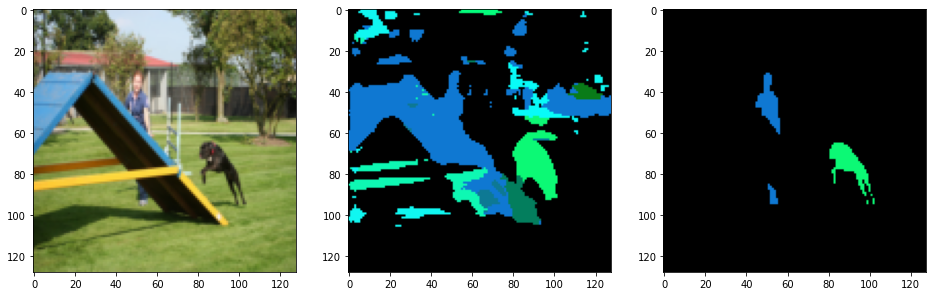

------------------------------ Epoch 155 ------------------------------
Loss: 0.290   Accuracy: 0.685


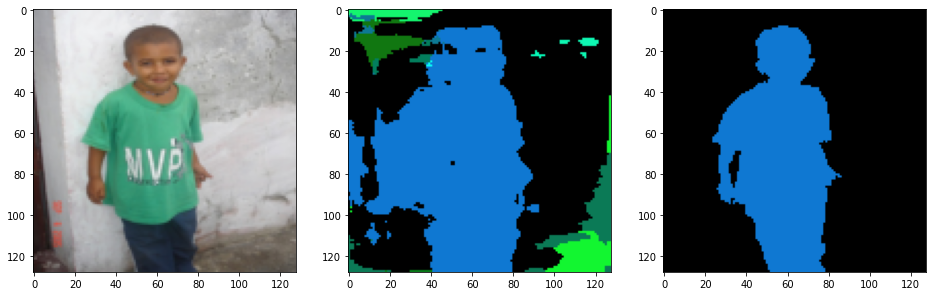

------------------------------ Epoch 156 ------------------------------
Loss: 0.309   Accuracy: 0.673


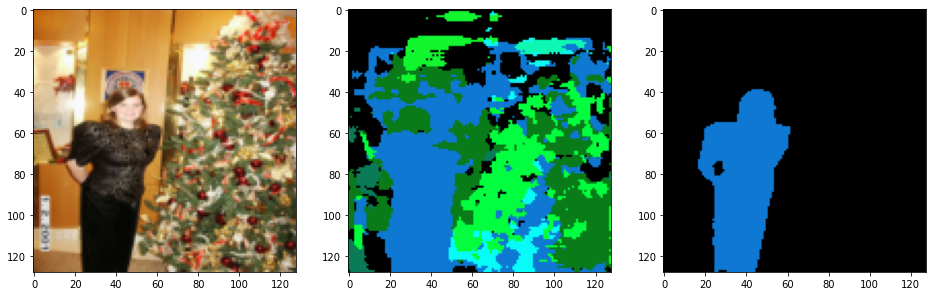

------------------------------ Epoch 157 ------------------------------
Loss: 0.268   Accuracy: 0.689


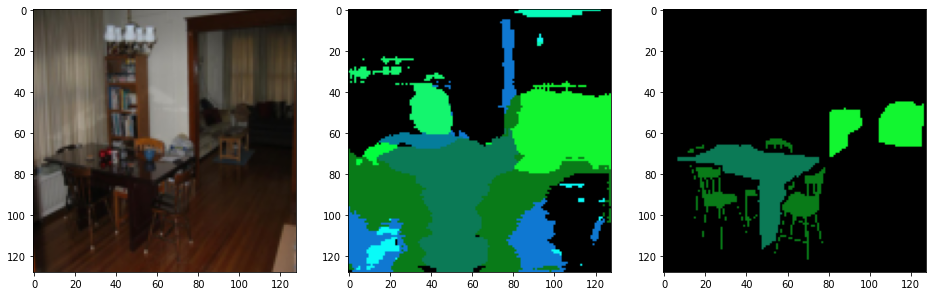

------------------------------ Epoch 158 ------------------------------
Loss: 0.260   Accuracy: 0.697


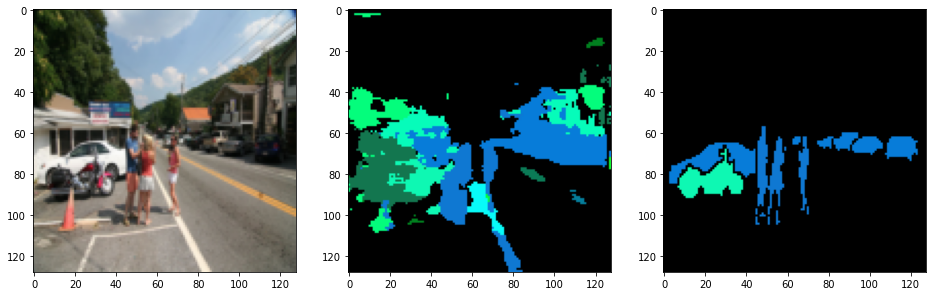

------------------------------ Epoch 159 ------------------------------
Loss: 0.275   Accuracy: 0.686


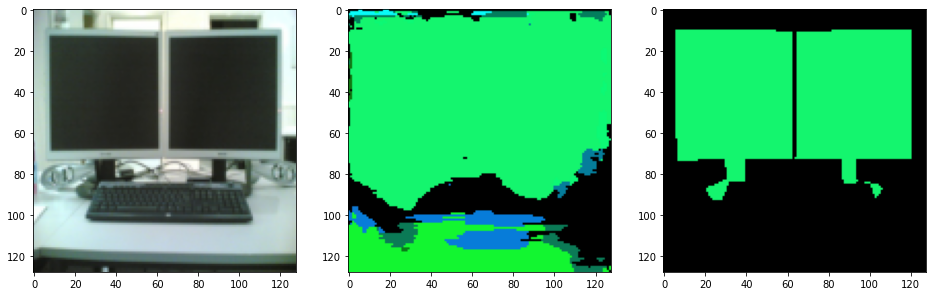

------------------------------ Epoch 160 ------------------------------
Loss: 0.341   Accuracy: 0.675


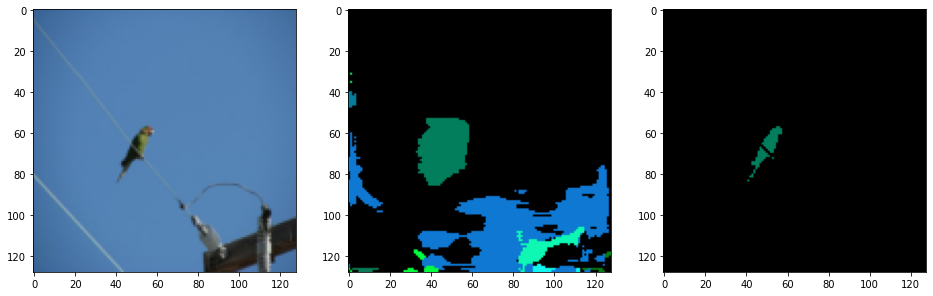

------------------------------ Epoch 161 ------------------------------
Loss: 0.330   Accuracy: 0.672


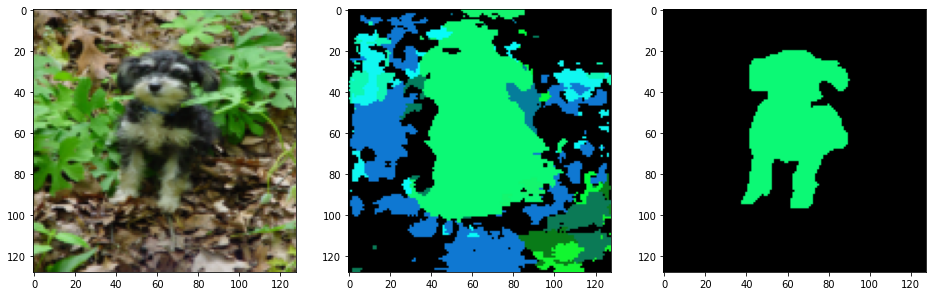

------------------------------ Epoch 162 ------------------------------
Loss: 0.327   Accuracy: 0.677


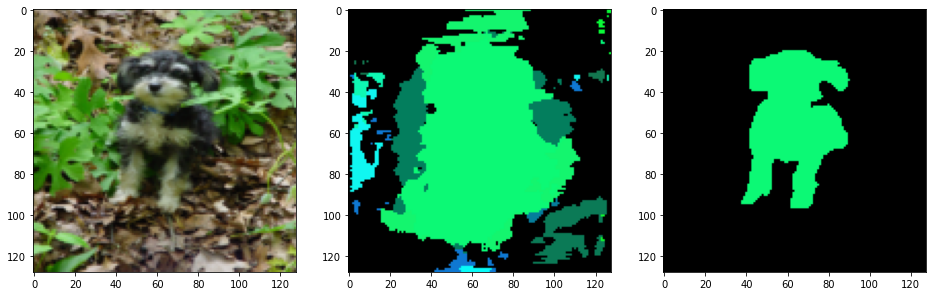

------------------------------ Epoch 163 ------------------------------
Loss: 0.439   Accuracy: 0.640


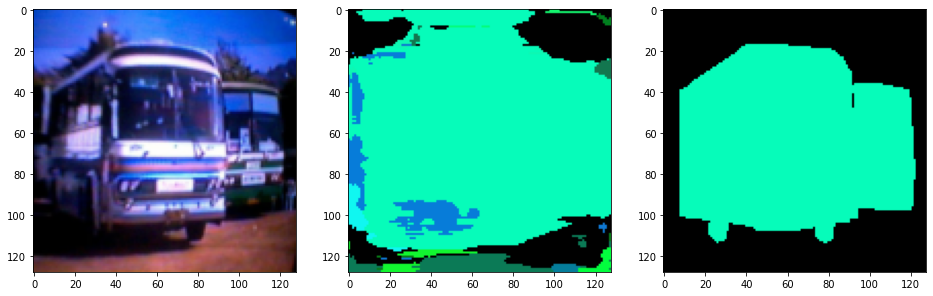

------------------------------ Epoch 164 ------------------------------
Loss: 0.293   Accuracy: 0.691


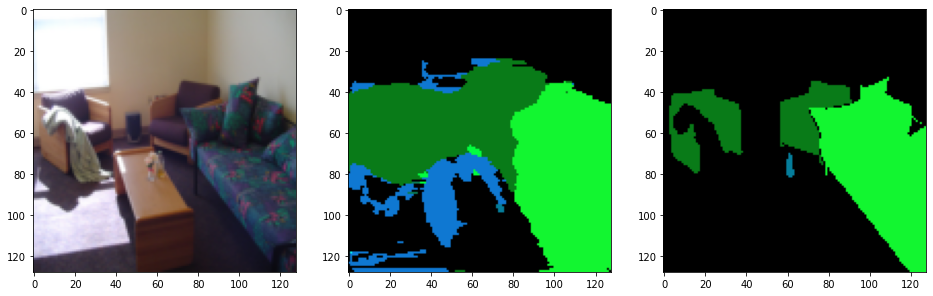

------------------------------ Epoch 165 ------------------------------
Loss: 0.219   Accuracy: 0.720


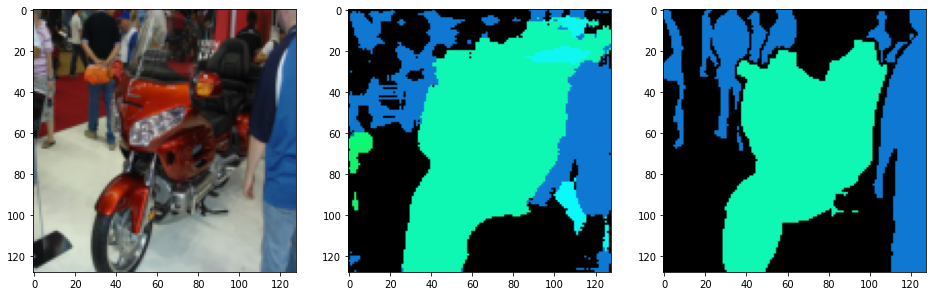

------------------------------ Epoch 166 ------------------------------
Loss: 0.221   Accuracy: 0.718


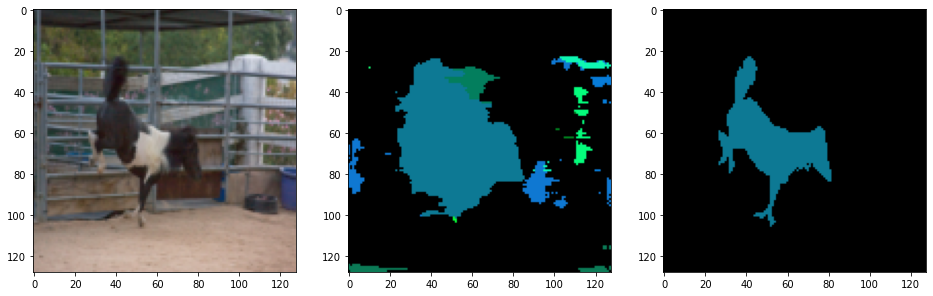

------------------------------ Epoch 167 ------------------------------
Loss: 0.204   Accuracy: 0.721


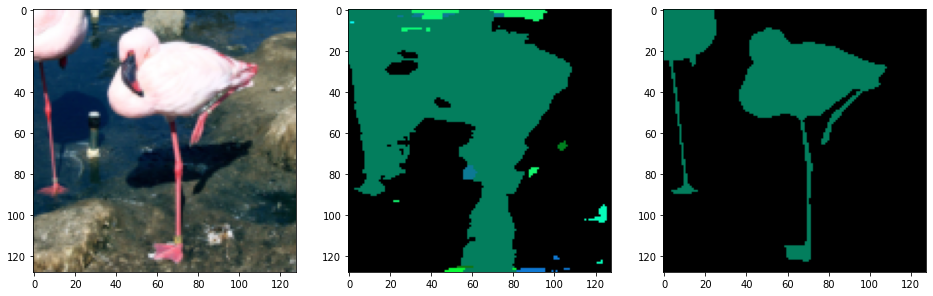

------------------------------ Epoch 168 ------------------------------
Loss: 0.196   Accuracy: 0.730


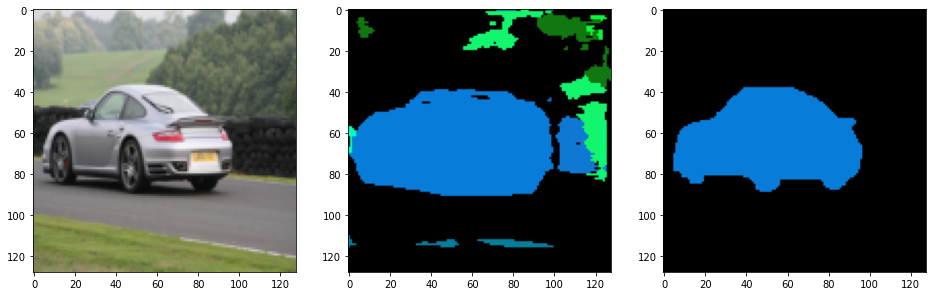

------------------------------ Epoch 169 ------------------------------
Loss: 0.465   Accuracy: 0.650


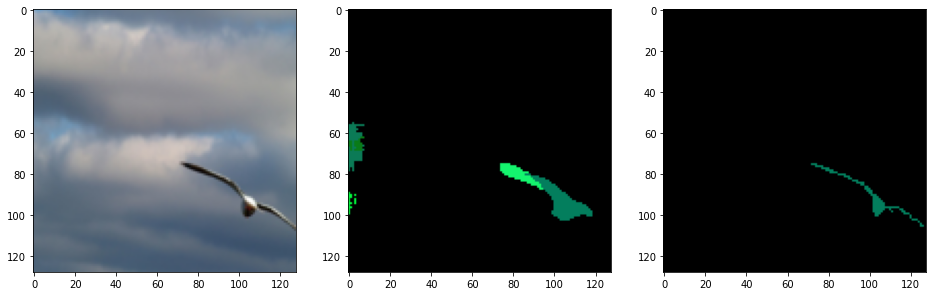

------------------------------ Epoch 170 ------------------------------
Loss: 0.434   Accuracy: 0.663


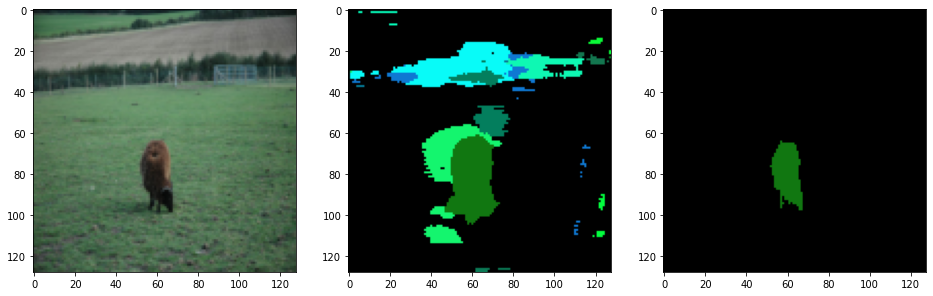

------------------------------ Epoch 171 ------------------------------
Loss: 0.351   Accuracy: 0.677


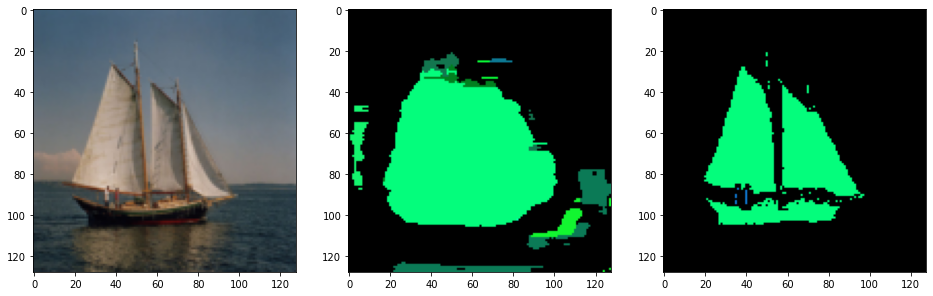

------------------------------ Epoch 172 ------------------------------
Loss: 0.217   Accuracy: 0.731


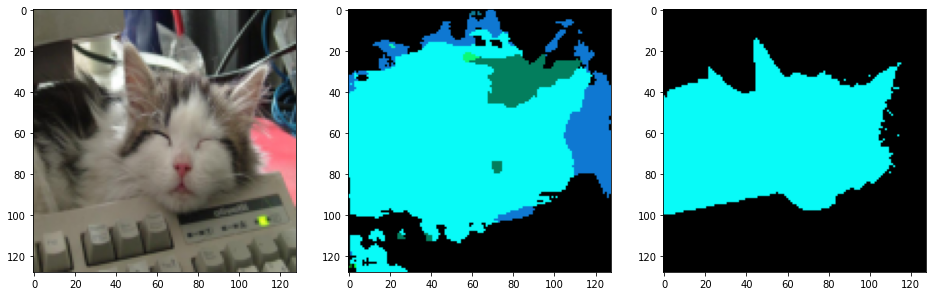

------------------------------ Epoch 173 ------------------------------
Loss: 0.222   Accuracy: 0.723


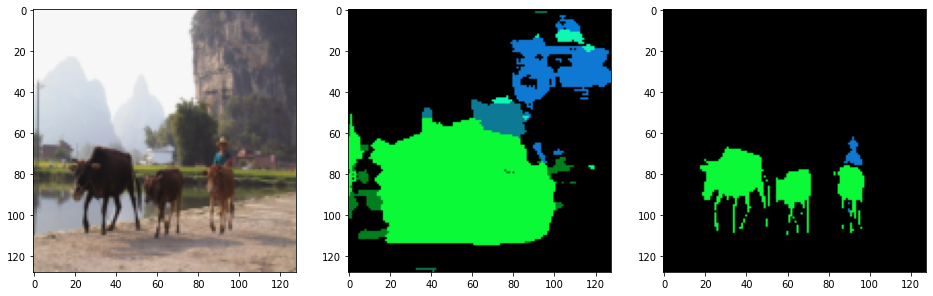

------------------------------ Epoch 174 ------------------------------
Loss: 0.196   Accuracy: 0.735


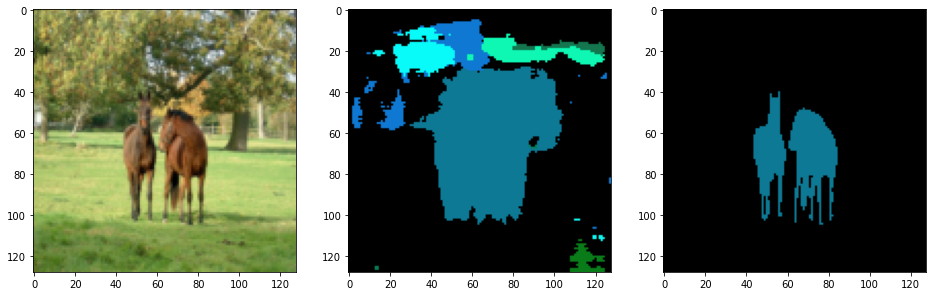

------------------------------ Epoch 175 ------------------------------
Loss: 0.191   Accuracy: 0.745


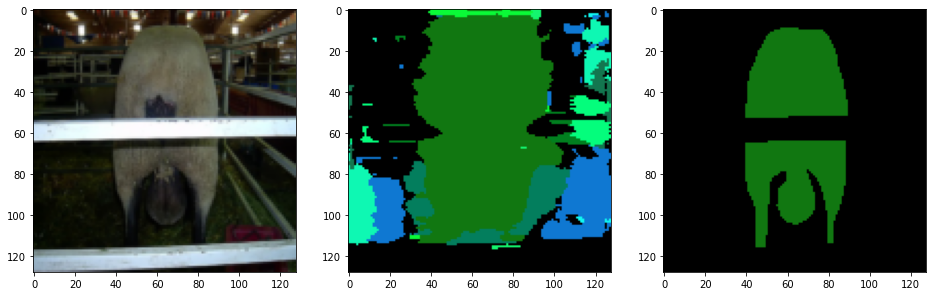

------------------------------ Epoch 176 ------------------------------
Loss: 0.172   Accuracy: 0.756


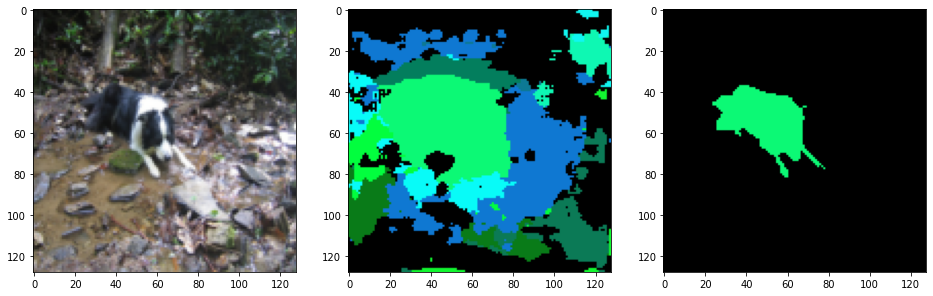

------------------------------ Epoch 177 ------------------------------
Loss: 0.174   Accuracy: 0.752


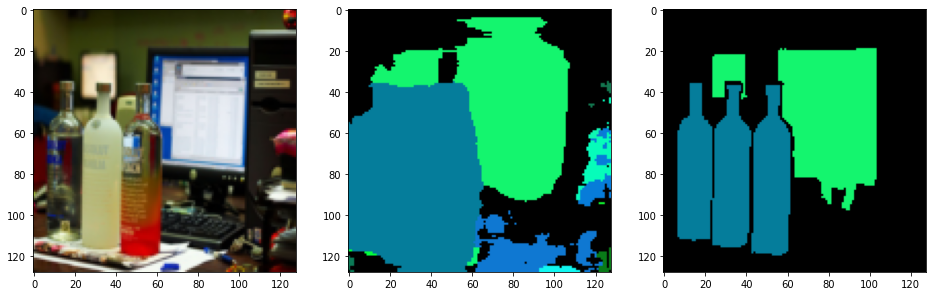

------------------------------ Epoch 178 ------------------------------
Loss: 0.161   Accuracy: 0.763


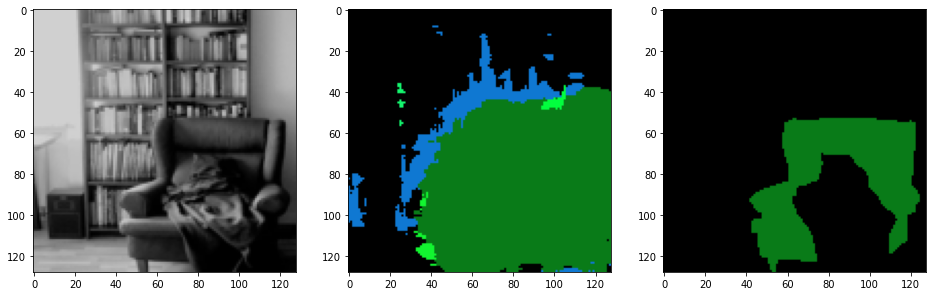

------------------------------ Epoch 179 ------------------------------
Loss: 0.149   Accuracy: 0.773


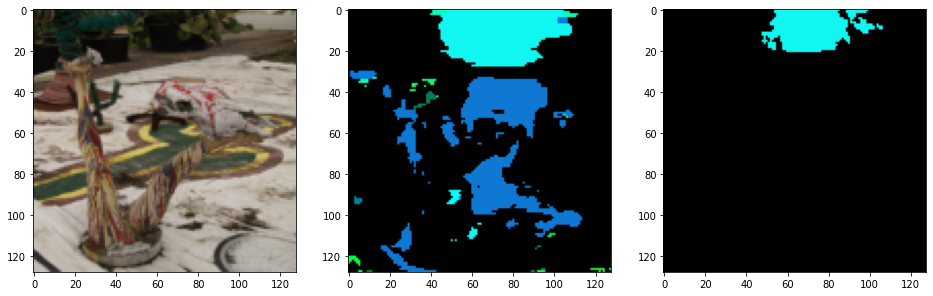

------------------------------ Epoch 180 ------------------------------
Loss: 0.507   Accuracy: 0.677


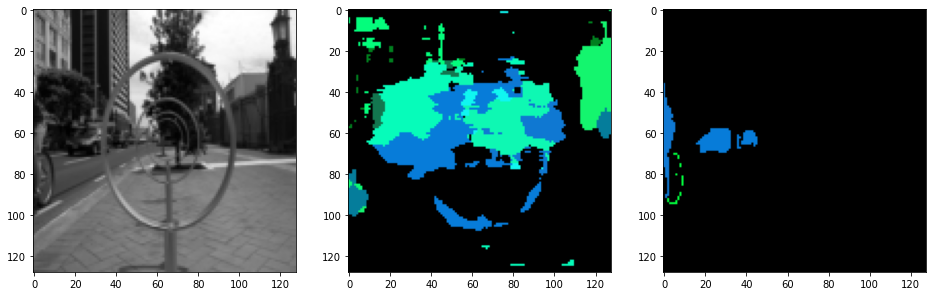

------------------------------ Epoch 181 ------------------------------
Loss: 0.499   Accuracy: 0.657


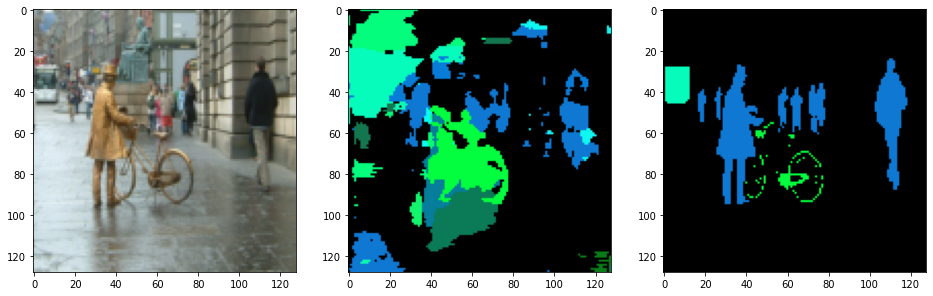

------------------------------ Epoch 182 ------------------------------
Loss: 0.259   Accuracy: 0.718


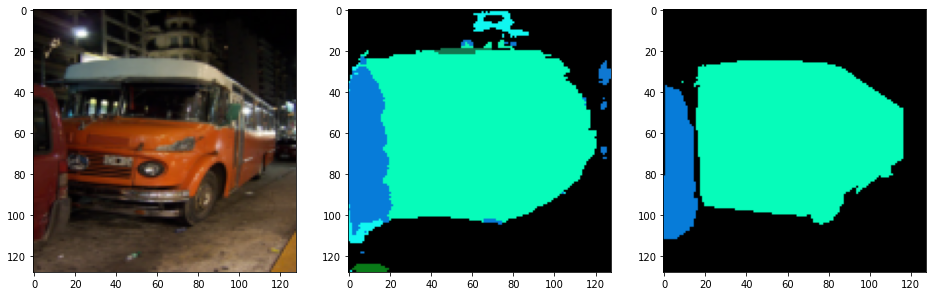

------------------------------ Epoch 183 ------------------------------
Loss: 0.211   Accuracy: 0.747


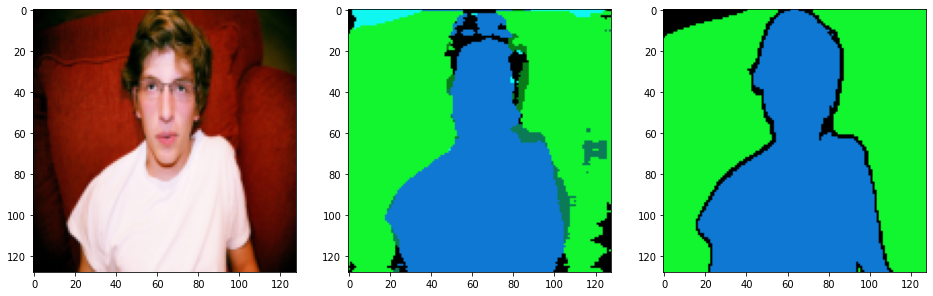

------------------------------ Epoch 184 ------------------------------
Loss: 0.169   Accuracy: 0.759


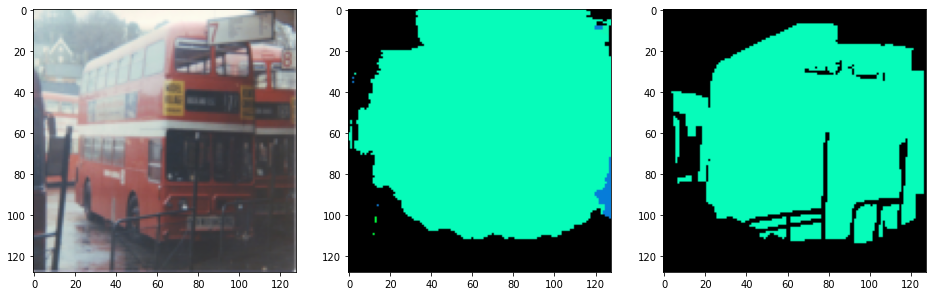

------------------------------ Epoch 185 ------------------------------
Loss: 0.148   Accuracy: 0.774


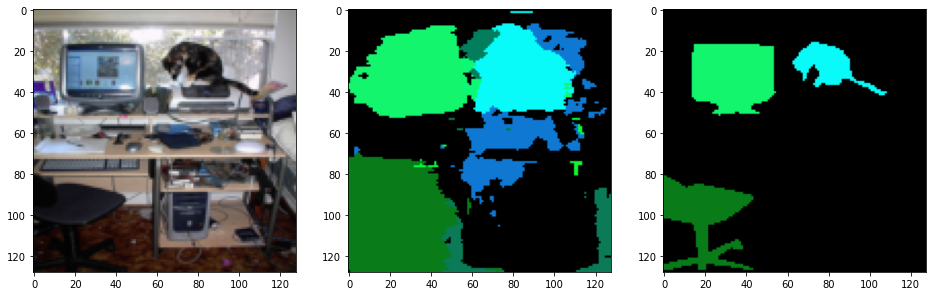

------------------------------ Epoch 186 ------------------------------
Loss: 0.143   Accuracy: 0.780


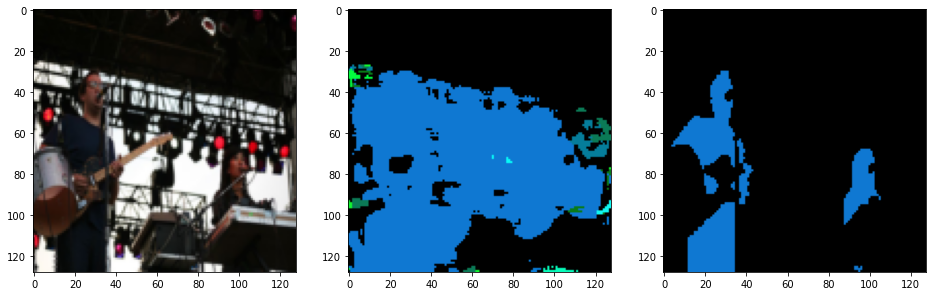

------------------------------ Epoch 187 ------------------------------
Loss: 0.152   Accuracy: 0.773


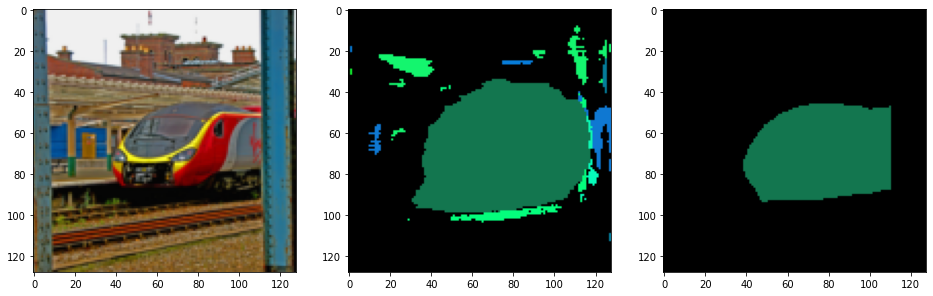

------------------------------ Epoch 188 ------------------------------
Loss: 0.137   Accuracy: 0.792


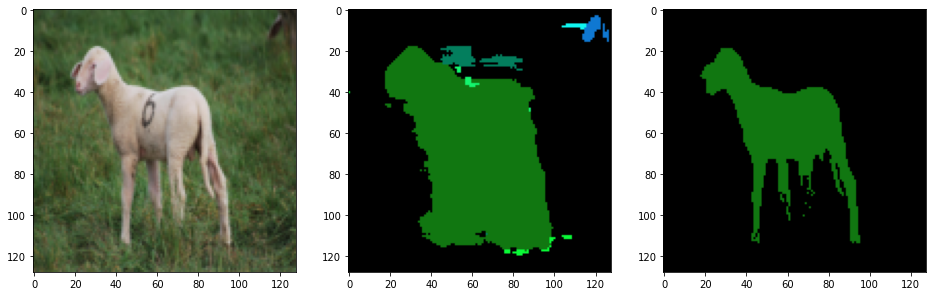

------------------------------ Epoch 189 ------------------------------
Loss: 0.143   Accuracy: 0.788


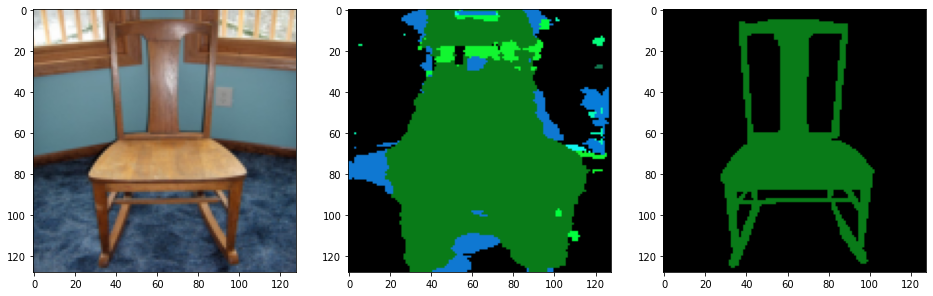

------------------------------ Epoch 190 ------------------------------
Loss: 0.159   Accuracy: 0.786


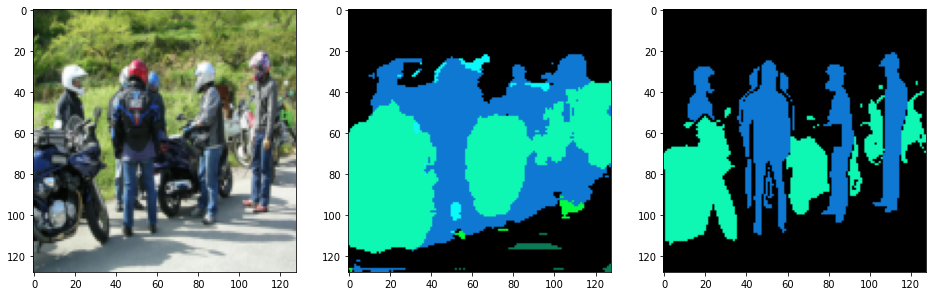

------------------------------ Epoch 191 ------------------------------
Loss: 0.613   Accuracy: 0.640


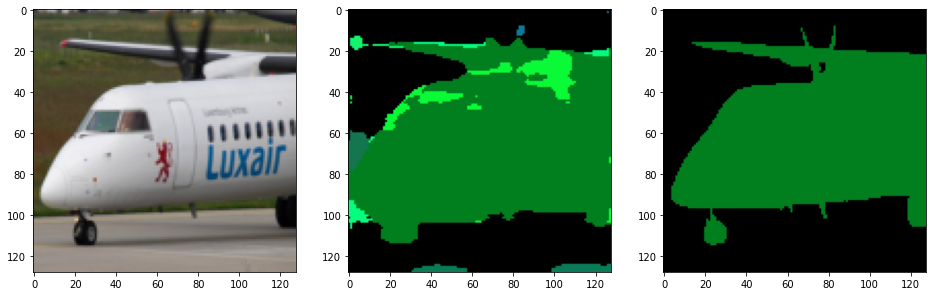

------------------------------ Epoch 192 ------------------------------
Loss: 0.388   Accuracy: 0.706


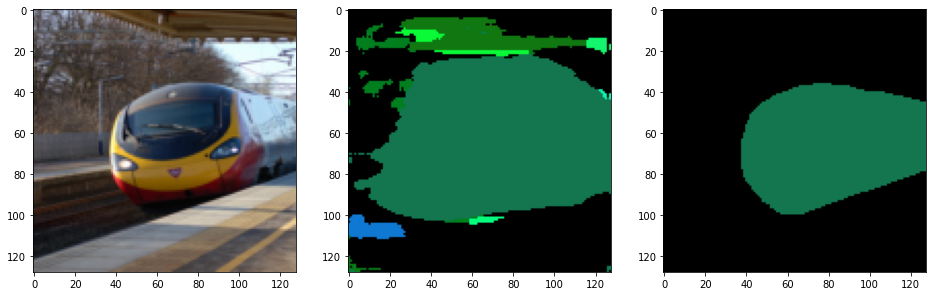

------------------------------ Epoch 193 ------------------------------
Loss: 0.230   Accuracy: 0.742


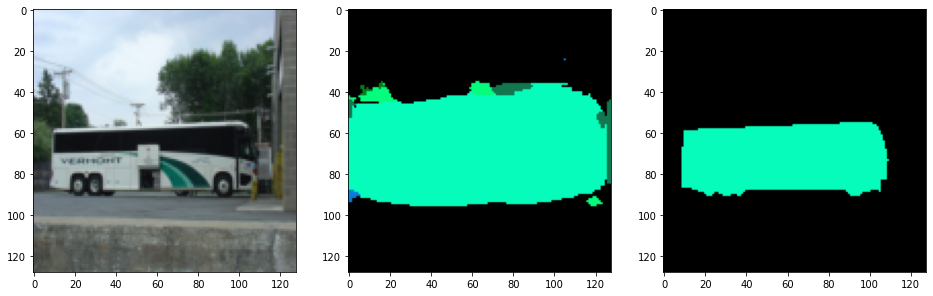

------------------------------ Epoch 194 ------------------------------
Loss: 0.165   Accuracy: 0.768


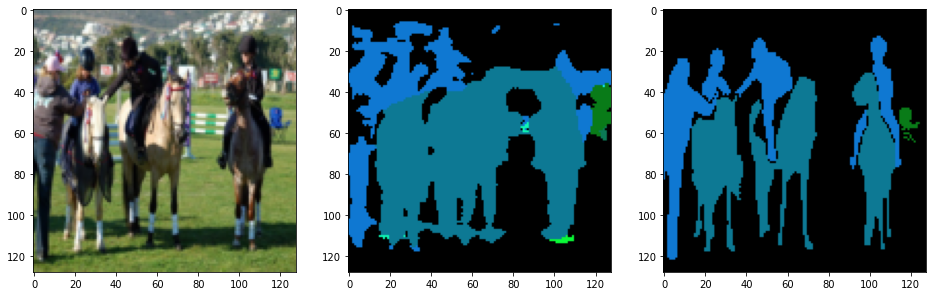

------------------------------ Epoch 195 ------------------------------
Loss: 0.146   Accuracy: 0.777


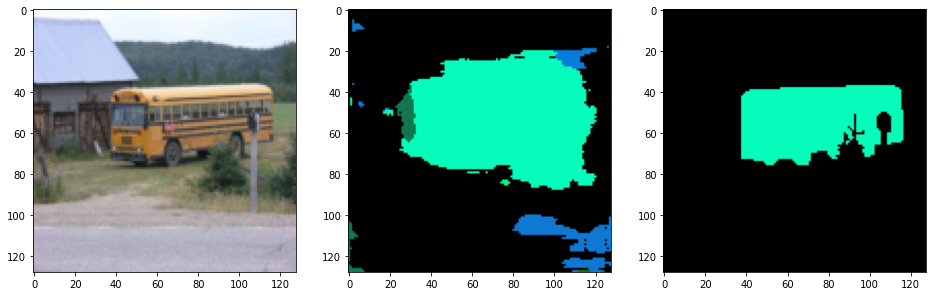

------------------------------ Epoch 196 ------------------------------
Loss: 0.197   Accuracy: 0.765


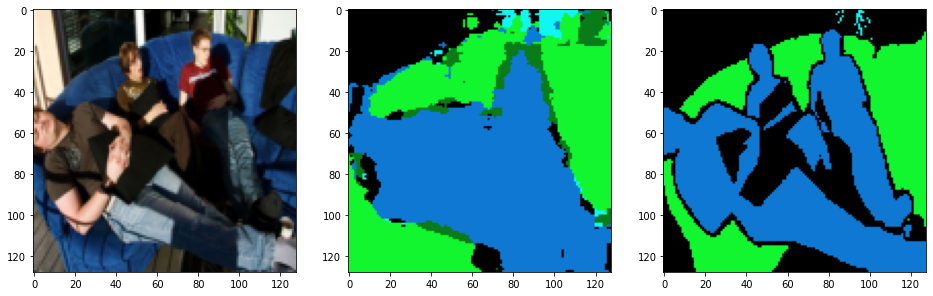

------------------------------ Epoch 197 ------------------------------
Loss: 0.176   Accuracy: 0.783


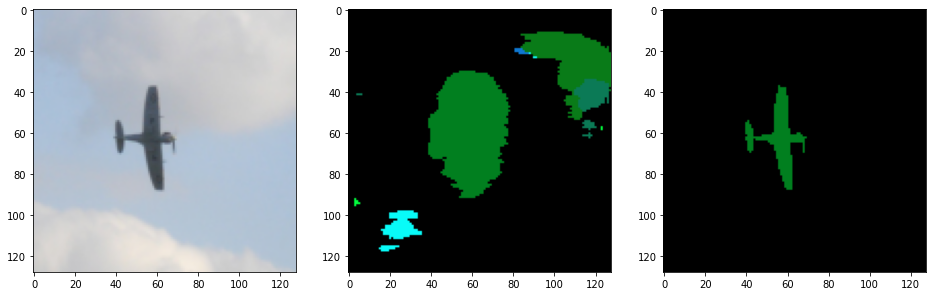

------------------------------ Epoch 198 ------------------------------
Loss: 0.186   Accuracy: 0.768


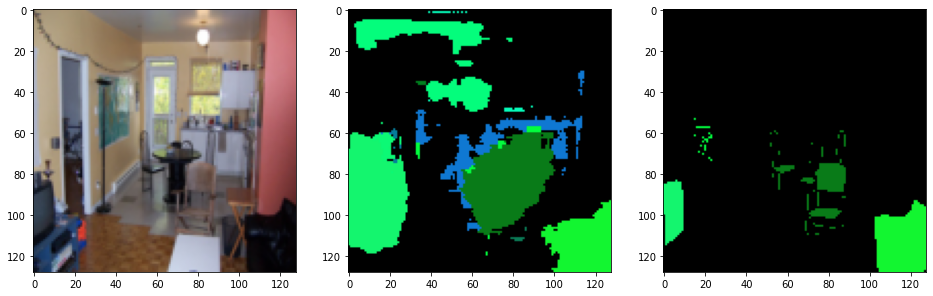

------------------------------ Epoch 199 ------------------------------
Loss: 0.180   Accuracy: 0.773


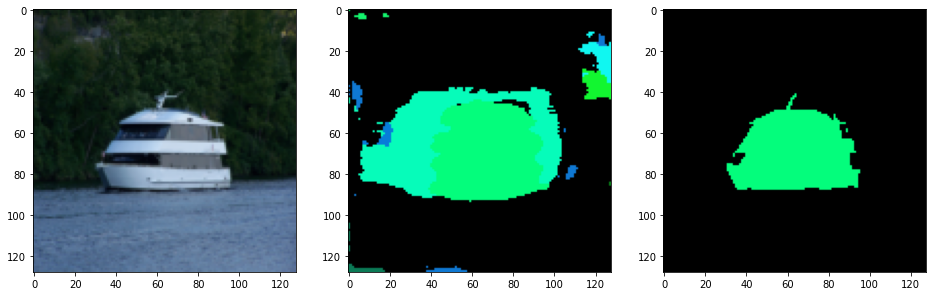

------------------------------ Epoch 200 ------------------------------
Loss: 0.173   Accuracy: 0.779


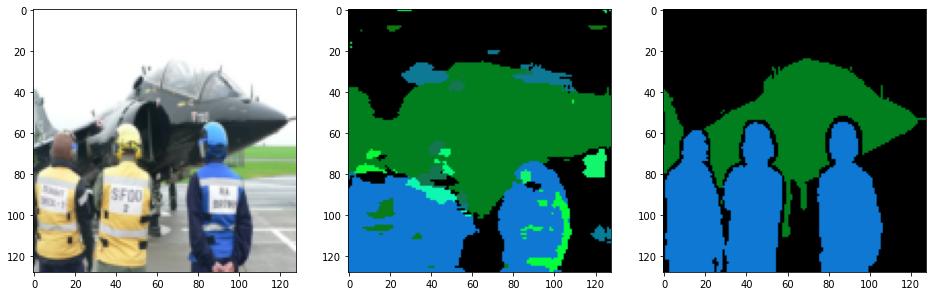

In [18]:
for epoch in range(epochs):
    losses_per_epoch = []
    accuracies_per_epoch = []
    # go over all batches
    for step, (input, target) in enumerate(train_loader):
        model.train()
        input, target = input.to(device), target.to(device)

        target = preprocess_target(target)
        pred = model(input)
        
        optimizer.zero_grad()
        loss = criterion(pred, target)
        loss.backward()
        optimizer.step()

        acc = get_accuracy(pred, target)

        losses_per_epoch.append(loss.item())
        accuracies_per_epoch.append(acc)

    mean_loss = np.mean(losses_per_epoch)
    mean_acc = np.mean(accuracies_per_epoch)

    print(f'{"-"*30} Epoch {epoch+1} {"-"*30}')
    print('Loss: %.3f   Accuracy: %.3f' % (mean_loss, mean_acc))

    save_result(epoch+1, input, pred, target)

    if epoch % save_model_every == 0:
        save_model(epoch+1, model)

## Test

Test against 100 unseen images, in the order of input-prediction-label.

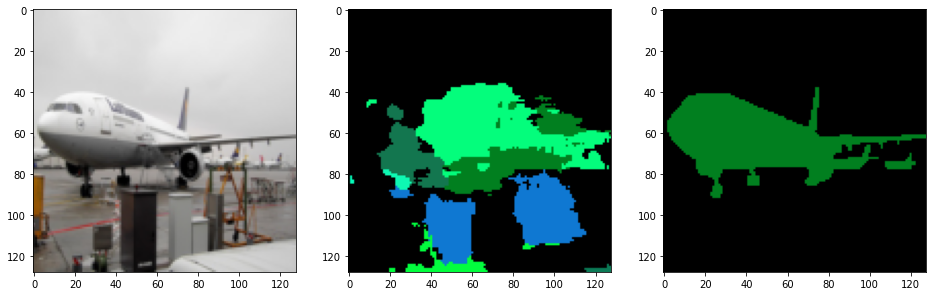

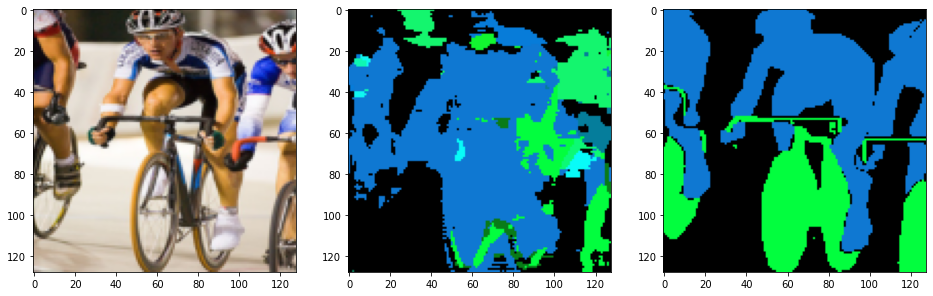

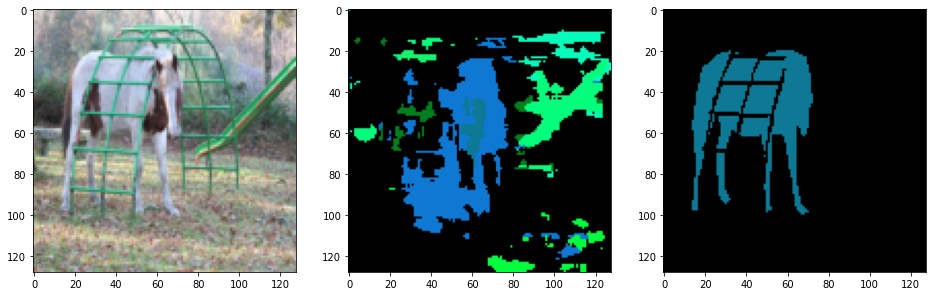

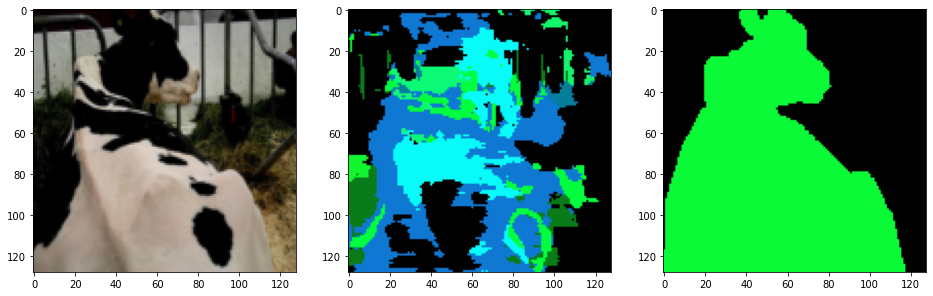

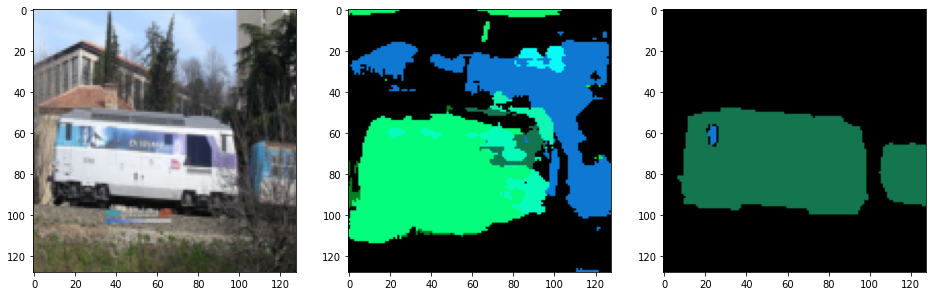

...

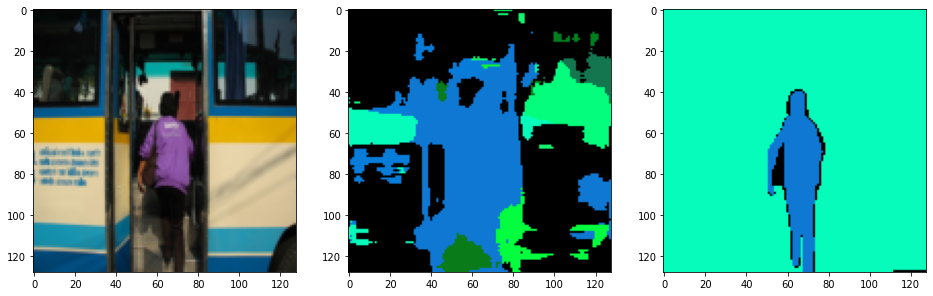

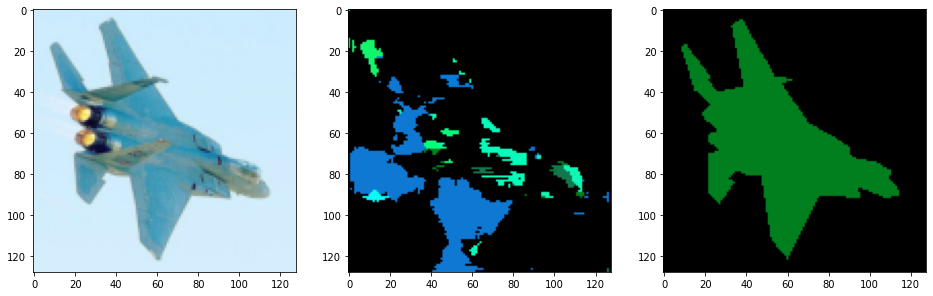

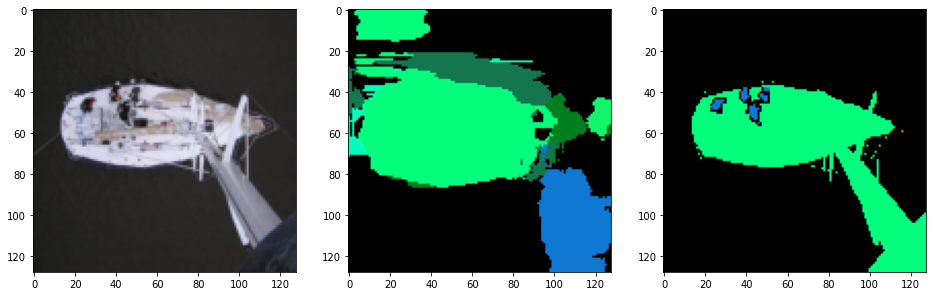

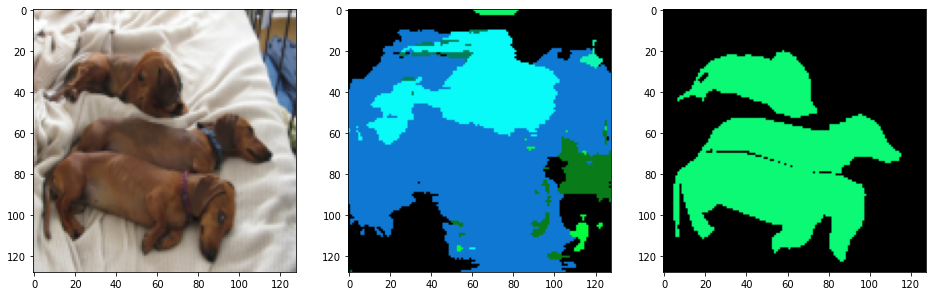

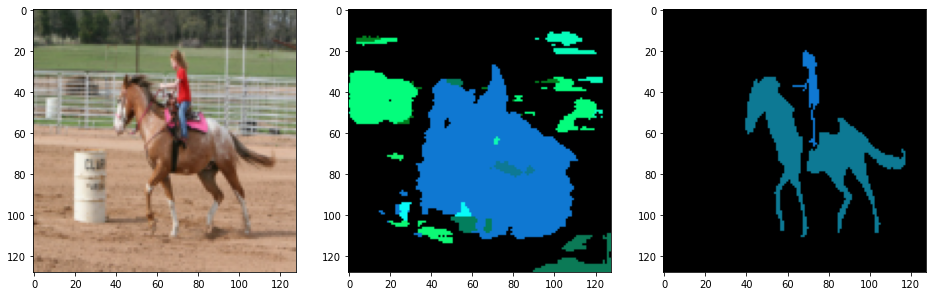

In [19]:
for step, (input, target) in enumerate(test_loader):
    model.eval()
    input, target = input.to(device), target.to(device)

    target = preprocess_target(target)
    pred = model(input)

    save_result(step+1, input, pred, target)
    